In [1]:
from PIL import Image



import math
import itertools
import cmath
import pandas as pd
import numpy as np
np.random.seed(42)
from scipy.spatial.distance import pdist, squareform
from scipy import linalg as la

#------ Sklearn ------#
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import Normalizer, StandardScaler
from sklearn.preprocessing import LabelEncoder


#------ Plots --------#
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from matplotlib import pyplot as plt
import seaborn as sns
sns.set()

LINE = go.scatter.Line(width=1)
DOT_LINE = lambda color: go.scatter.Line(width=1, dash='dot', color=color)
MARKER = go.scatter.Marker(size=6)

TEXT_ANNOTATION = lambda x,y,text: go.layout.Annotation(
            x=x,
            y=y,
            xref="x",
            yref="y",
            text=text,
            showarrow=False,
            )

ARROW_ANNOTATION = lambda x,y,text: go.layout.Annotation(
            x=x,
            y=y,
            xref="x",
            yref="y",
            text=text,
            showarrow=True,
            arrowsize=2
            )

SLIDER_STEP = lambda name, label: {'args': [
                                        [name],
                                        {
                                            'frame': {
                                                'duration': 80, 'redraw': False},
                                                'mode': 'immediate',
                                                'transition': {'duration': 80}
                                        }
                                    ],
                            'label': label,
                            'method': 'animate'
                           }

AXE = lambda x,y,name,color:   {
                                'type': 'line',
                                'name': name,
                                'x0': x,
                                'y0': y,
                                'x1': -x,
                                'y1': -y,
                                'line': {
                                    'color': color,
                                    'width': 1,
                                    'dash':'dot'
                                }
                              }


DEFAULT_PLOTLY_COLORS = [
    '#1f77b4',  # muted blue
    '#ff7f0e',  # safety orange
    '#2ca02c',  # cooked asparagus green
    '#d62728',  # brick red
    '#9467bd',  # muted purple
    '#8c564b',  # chestnut brown
    '#e377c2',  # raspberry yogurt pink
    '#7f7f7f',  # middle gray
    '#bcbd22',  # curry yellow-green
    '#17becf'   # blue-teal
]


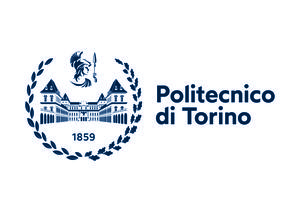

In [2]:
%%html
<img align="center" src="data:image/png;base64,/9j/7gAOQWRvYmUAZAAAAAAA/9sAQwAIBgYHBgUIBwcHCQkICgwUDQwLCwwZEhMPFB0aHx4dGhwcICQuJyAiLCMcHCg3KSwwMTQ0NB8nOT04MjwuMzQy/8AAFAgA1AEsBEMRAE0RAFkRAEsRAP/EAB8AAAEFAQEBAQEBAAAAAAAAAAABAgMEBQYHCAkKC//EALUQAAIBAwMCBAMFBQQEAAABfQECAwAEEQUSITFBBhNRYQcicRQygZGhCCNCscEVUtHwJDNicoIJChYXGBkaJSYnKCkqNDU2Nzg5OkNERUZHSElKU1RVVldYWVpjZGVmZ2hpanN0dXZ3eHl6g4SFhoeIiYqSk5SVlpeYmZqio6Slpqeoqaqys7S1tre4ubrCw8TFxsfIycrS09TV1tfY2drh4uPk5ebn6Onq8fLz9PX29/j5+v/aAA4EQwBNAFkASwAAPwD3+vf69/r3+iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiigkAZPSjpRQTgZNcevj/AE281m50+ynhEdrDJLLdTE7MoVDBQOT1PPqpFYo8RWs97LbwSIFiRmeVzx8pGQB36n8jRXOL4usrnUp7S1liCQRu8k8h+XKkZAHU9Tz/ALJrY8M6td67oyanc2H2KO4PmW0bPucwkAozjorEc7ecZHOau6VeTahYrdS2/kLKd0SFssU/hLehPXHaitHQ9RuNW0xL6e0Nqkx3wIzZYxHG1m9CeuOccVY1nV7fQ9Ne/ugxiR0VtvUbmC5+gzk+wNS3t5HYWpuJc7AVBx7kD+uaKn1LUYdLsmu58+WrKpx7sBn8M5/CtCrFFW6KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK4jUPin4etNB1bVoJHuorC5+xIEwBcz7QdsZ7jnlvQE8jrg3Pi3TYNOvLyNmlS2l8hdv8Ay1kxnCn09/Y0Vy17490e20jUdQid7iOzn+zKF4E8uAdqHuOevsTVP4Z674v8VC71vXY7e00uQbbK2iiwX55fceSB0B6HJPQDMPhbUNa1fzr/AFBYobRhiCJExn1bJ5I7e/NFV/A+q+I9f+0apqyQ29g422sEceC3PLbjyR2B78n0r0Oukorsa57x1NdweCNXexSR7k25RBGCW+YhTjHsTz2rN195o9BvGtwxl8shQoyeeOPzorH8VyXEXhbUWtFdpzCVUIMnnjj8DXyhDbWml3Vve6/ez+RPaG5isbORvMkUnYiM/RAy5bPPygccgV5CkUNrLHNqE7+XJD5qQQMd7AnaoLdFyMnvwPcUV8/xw21lPDcatcy+VLbefHa2rne6k7VUt0UEZPf5QPUV9O+HvFVrq2j2k/hyWK+s4I1ie2aN4ZjhcfI0mAxGOh4P94V6rpurw3llDJpjpcQIgUxFWRzgfwluv+eaK9z0bX4NR023m0WSO7tokVGgKNHIcD+EvgN9P1qp45v4vEPw71B9OSeTcssGxomSRJtjIEKkAg7yB9SKg1+4XUvDNy1qsjEq8e0oVYSYICkHodxAoqt4qvE1jwXevYrK7FZIghjZXWXaVCkEAg7iB9a7m2MhtojKMSbBuHocc1vxbjEm8YbAz9aK6uEuYIzIMPtG4e+Oalp9FPrhvHviPxR4Umt9U0vSYtV0ZUxexLxLCQw+ZSDyCDjG04Iz3rA8Q6nq2jvHd2lml3Yhf36jh056jnnIPp2orlfF2ta94fkhv7DTo7/TAv8ApSDiSLBHzAg8ggnjHGK1NK8feHNV0ex1L+0YbNL1mSKK8kWKTepAZME9QSOmeoq3Z+IdMu7KC6+0pCs5Kok7BG3A4K4z1BI/Oir2n+LdG1DTbW9+2x2y3LFI47lxG+8EArgnqCR09RXS1qUVuUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUVz3jeWceB9bNnPFFOLSRRK8oRUyMElj93APWs3XnkGg35hkRH8lgGZwoXjue1FY/iiSUeFtUNtLHHKLdwHeQIF45JY9ODXIfCKy8NXngr7BZ239oRWdyWmu7m1AjluGUbjEG5wq7VBIBxisbwZBpc+hfZ4YvtKQSkvNLDhXkI5KA84AwO3FFc58OrbRLnwx9kt4PtiW05MlxPbgJJMRyYw3OAMDJA4xXp4AAwBgCurAwMCiu7AAGB0paKKKhu7WK+sp7Sdd0M8bRyKDjKsMH9DTJokngkhkGUkUqw9QRg0VHcQR3VtLbyjMcqFHGcZBGDXzl8QvAtv4S8V6RPDbnVIp7NLaytp8HdPEFTMg4BQIQ/YEjB4zXmXiPw/Fo2r2Txxm6jkgWGCJ8HMiADLdiAvPpxzxRXi3jDwpB4d1/TZIojfRTWy29rBLg7pYwqgv0BUL83oSOeK2fh1BqGo6B4g1a3020uL+CWPa+pjzjOoXzDGhXGwYKbcDbz07C94ajuLnT9Su4raGS5jdcNdDf5gC7ioIxtGCuMcc9PQrT8GRXd7pOsX8NlbzXkMiYa+HmeaoXeUUjG0YK4wMc9Ow9LTw9YSeFDHGuoRDVLmC5uGuZT9o3NIhwxOdpAAXA4AGK6ldNtzpBVBcp9rlSWQyufMyWU4JPTHAx2xRXbpo9o3h8pGLyMX88U8zTyEzZZ1OCT0wMDA4AGK6+tmiujoooooooorx340r4durez8PNJ9h1u6nF3aSiArE0n3PncDGW6Z5wcE4FcV45GmzRwaaW8i/lkE0L+WQhbp8zDueme3GaK82+Jy6NcQ22js/2XVJ5RcW8giKxs/3fmYDqemeccE8V3Hh7xFbx31j4SvJHOt2+lQ3FwHcNzgKwLZyWzyfY5rf07Uo1uINHmZvt0VpHJIC2eehGe57/jRXV6PrMKXdr4euHY6pDp8U0wZg3OMEE5yWzz+NdVWtRW9RRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRVe/ufsen3N1sL+TE0m0d8AnH6VHcS+Rbyy43bELY9cDNFQ3c32azmn27vLjZ9o74GcV4T8PPD2ofEbwXrEWqarcwWtzrX2qcooYztsBdeeANxU9CPlHFef+G9NufEuh3yXd3LHDLf+a+0Z8w7QSOegzj8qK8o8HaNeeM/DOpx6hfzxW82qefKVAJlOwFl56DcQe/3RXt2iaJYeHdIt9L02AQ2sC4UZySTyWJ7knkmu7sLG302zjtLVNkUY4HUn1JPcmivUdL0u00bTobGyi8uCIYAzkk9yT3JPJNXVmiaZ4VkQyoAWQMNyg5wSO2cH8qnDoXKBlLqASueRnpRVoSxtI0YdS6gFlB5APTI/A0+nUU6iiiivDPiTb+I/EnxMtdEg22WlraMVu2iyRG2EmkHc/f2Dt8xPH3hwHiiPU9U8VRafGRBaCEkTFOQpwrt6/xbR9c+9FeVeN4da1vxzBpURW1sBbMRcGPJCHCSuO+fn2jtyT7128Oi6R4Jij1HVdYWzSaCCwncDZBcMisqvIrAqGKADPHTGea3ksbLQVW6u70QCRI7eRsYjlKggFgcgEqAPworqI9M03wuiXuoaktsssUVpMwG2KdlBVWdSCASoAzx061o+M7iR/DEN7p7ST2yzRyySWkqgiHk70OQGxwetWtclZtKSe2LSRB1dmhcZ2f3hyAccGir3iaZ30OK5sy8sAkR3e3kAIj/ALynIBxwetdJZzR3FlBNDL5sUkaukn98EAg/iK04HWSCN0fejKCreox1oratpEmtYpY5PMjdAyv/AHgRwanqSipaj8+LzxB5qecV3iPcN23OM49M96bvTzPL3Lvxu255x64opnmx+b5W9fMK7tmecdM49KyPFOjaFq2kSPr+nR3ttaK02DEXdcDJ2bfmzx0HWqWrWWn3lmzahbLPFCDJjYWYY5OMc547UVna9pulahpzvq1klzBbqZcFCzLgZO3HOeOg615tpd9p3jP4laL400C4YWNhbzWuoi6jCGBVVtjE/wC0GPOeAO3IrmLSe11zxRY67p0hEFvE8Vz5q7fLAB2nPvnr7UVxNhdWXibxtpnifSJmFraQy29556BfKUK205/2geueAPqK9X0nVbLXNLg1LTpxPaTrujkAI3DJHQ89Qa6+zvIL+0juraQSQyDKsBjIor0HT9QtdUsIr2zlEtvMNyOARkZx3+lXanoqzRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRXOax4z0jRvEEGiXzss89lNeA4BXZGMkH3IDkf7prMvdcs7LUo7CckSSQPODjjavUfln8jRWLqPibTtN1mLSrpmEs1rLcg442pyR9SAx/wCAmuF+CR1LUYtU1eWJrPRXbytNsUJ8qNdzO5H945KgseScjtisDwJ9quUu711aCxY7LW3H3FGSzEep5GT659KK5X4XfbryO/1KRGttNdvLsrRSRGg3FmIHc8gFj1OfSvRvEuv2/hzQ7nUZgHaONmih3hTKwUnaCfp+VdNqmoR6ZYS3LgMVUlE3AFyBnAz9KK7PW9Wh0XSp7yQB2RGMcW4KZGAJ2jP0r5h8O+Otd07xenjTUJy8V/ckXKo4PmRLgOgTOQFUgrn+5XlWm6/qFrrA125k3JcS/vQG+8gwGGPQAgj/AHaK8L0bxVqtl4hXxPeS7o7uc+eFYfNGMBl29QFUgj/dr6yhljnhSaJ1eORQyOpyGB5BFevo6yIrowZWGQR3FFfQcciSxrJGwZHAZWHQg9DSTxedC0e94yRw6HDKfUUSJvQruZc9Cp5FFJLH5sbJuZCejKcEe4rh9Rfxjp2q29x/wjVh4hNuHFveW94LSZFYAMHR8qc4GcHBwDgYFYNy2t215HJ/ZdvqXlgiOeObyXUHqCp47DoccdBRXLXjeJbPUIZf7EtNY8kMIbmG5FvKobAIZWyOcDoccA4Fcr44m8VeKbD7Bc6G8B86ONbS33TrHIxwGkl2hWIGThcqoBLNkqKyNek1bVbf7PLYMn7xVEMWZArE9WfABwOcDgDOTkgUVgeKZdf120+yTaU8Z81EFvAGlCOxxueTABIGTheFAOTkgV1PgDwtd6d4W1PR9UgeKymvJ2toS/KQsTgDH3emce9a/h3SZbXSbqyuo2SB55DEhblUJ/T1/Git/wAI6DPZaDfabfRNHay3MrQxluVjY9OOnrj3rtrKzg0+wt7K1TZb28SxRJknaqgADJ9hW5BDHbW8cES7Y41CKM9ABgUV09tbxWdrDbQLthhRY0XOcKBgD8hSX17Bp1hcXt1II7e3jaWVz0VVGSfyFE88dtbyTysFjjUuzHsAMmikurmGytJrq4cJDChkdj2UDJNfJ93478RDxenjyF/lS5MYheUYEbDIhK9duwLzjrk9a8gm8Qal/bK+IEPCy7Qhb+E8hCPTbj8eaK+frnxXrP8AwkSeLI24SYoI2cY2MMiIj02Y59eetfVOj6rba1pkN7bsCsijem4MY2wCUbHGRmvW7K7ivrVJ4iMMOVyCVPcH3FFe+adfw6nYx3MJBDgblyCUbHKnHcV5D4t1fwt4R1rxF4bsNFn02/1jTnBuNmbeZmU7QsYPQ5cFgBgjoa4zWL3SdHvtS0u3sZLW4vbZv3u3MbkjjC56csM8YIorzrxDqOg+HtU1nRLTTJbK71KybM2zMMjFTtATPQ5YZGMEV3/ww0+50r4caHZ3sckVytvueOU/Mu5iwB9OCOO3Sui8KW0tn4Y0+CdWSVYslXPIyScfrRXXeBLKfTvBOlWtyjxzLDlkkPzLkk49uCOO1ddWzRXRVh+KvFml+DdKTUtXeVLd5hCDHGXO4gkcD2U1Q1fWLTRLNbq9ZxEzhBsUscnPb8KKyvEHiGw8Naet9qLSLC0giBjQudxBI4H0NcpZfHLwLe3aW/8AaU0Bc4Dz27KgPuecfU8VjweP/D88yx/anjycbpIiFH1Paiuftfir4TurhYft0kW443ywsqj6nt+NejI6ugdGDKwyCDkEV0wIYAggg8giiu0VgyhlIKkZBHelpaKWuUPxC0V9W1vS7X7Tc3ejWslzdJHEcfJ1RSfvN9OPesf/AISSxa9v7SHzZZrGJpZQqen8I9TRXP8A/CY6W+o6pYW/nz3OmQNNOqRnHy9VBPVvpxUfgn4gWXi/wtPr0tu2l28ErRyG5kGwBQDuD8DHP4HNN0HxHBrWkPqLxG0jjcq3muNoxjnd0xzRTPC/jC18SeH5dXeE2EMUjI5ncbRgA53cDHP510mm6nZaxp8V/p9wlxay5McsZyrYJBx+INalrdQXtslxbSrLC/KuvQ84orbsb611Kzju7OZJreQEpIhyGwccflVupqKsUUUUUUUUUUUUVx/xB8fQeAdMtLybTri9+0z+SFiYKF4ySSQefQd6xfEniKPw5aQzvayT+bJsAQ4xxnr/ACHeiub8Y+L4vCFhb3MtlNdedL5YEZCheM8k9/Qd66u3mFzbRTqroJEDhXGGGRnBHY1sRuJYkkAIDAHDDBGfWiuhhlE0EcoVlDqGAYYIyM8j1qWnUU+iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiivIPH+iSP8YPDGrzov9meQy3MsuPLjjiWVpN5PABV+/XmuM8R2Dt4z0m8cD7LsIld/uqqhy272waK858X6XI/xG0HUZVX7CI2E8j/cREWRn3dgCG716ho17Yaho1pd6UUNhLGGgKJsXZ2wuBgfhXV2M9tdWMM1mVNu6AxlV2jb2wO1Fd3pl1Z3umW9zp5U2kkYaEou0be2B2FeR+MPDHj3WPE63c2t6PaqVeCytWCMoRiM7Vk6uTt+bGc4xjpXHazpXiG91UTSX9nECGjgiO0jaSOgbq3Tnr0orzzxFoXizUddFxLqmnQAhobaA7SoUkZwH6sfl569MYrlB8IvFLW0Gitq2kyR2ZaX7MDGJAD13EfPjD9+BurI/wCEM1UxR2Ju7NlgJcRAqGAPXJHOPm7+tFYH/CutdaCHTDf6e6WpMggBQOAeuSPmxhu/96vW/hnc3NnpM3hy/DpNpCpGBO37zYRxntt4OCDjH0rsPC8ksFm+mXAZXswqgSH5tuOM+3oaK9C8ETTW2nyaLdB1k05VQCU/PtI4z7ccHpXTeH/EWl+J9Oa/0m5We3WV4Sw7Mpwfz4I9QQa1dO1O01W2NxZyiSMOyE+4OP8A6/0Iorc0jWrDXbI3enziaESPESOzKcH/ABHsRWrVuir9FFFFFFFFZOueJNL8OJZvqlysAu7lLWHPd26fQDue1U7/AFO00xYTdyiMTSrEme7H+nvRWfqutWGirbNfziIXM6wR57s3T8PU9q5D4otd6zaxeE7JXZ9QjMkoibD7FI69lTI5J9MVjeLDLfQpo8IJNypZwh52g9/Qe9Fc748M+p26eH7ZWZrxC0gjbDbQe/ouep9sV5f/AMKi8WGCTRF1fSAGm+1G3HlmUNxzk/Pt6cZxXK/8Ibq5jaw+2WeC/nGMbd2fr1x09qK4X/hXevtC2ljUdPAaT7QYRsLg8c5+9jpx0rsvAvh7xzpPiWa8/trSL20ndUvrePYqjaMZCx8K+M9ue/ttaDpuvWeqPOL6znhkYLcRrtAGOMgL0b+feiuk8LaP4q0/XJLkanp1zbysq3cKbQoxxkBPutj257+3V/EHS/Bcg0/U/FUqWc0MyrbXYJV9wywXIByOCcHitfxHa6E32a61d1gdJAIpgSGz1xx1HHQ0Vv8AjCx8MP8AY77X5EtpI5QsFwCVbcPmC5A5HGcGsHwze3998f8AxV5pf7Na2SQIkkpbYMoRsA4AY5b2zWfpU9xcfEXV95byooFjVWfO0fKeB78misnQ7q7uvi9r/mFvIgtUiRXkzsGVI2jpgnJr1auuorv68k/aJ/5Jzbf9hKL/ANAkrjviV/yLEf8A18p/6C1FeefGbnwVCB1+2p/6C9eceM/FvgjWfh7pukaPpqya6qwL5sdmI2RgoD/NjLZ5GOc5z2rmNc1nQb7w5bWVlbBtQAjG9YNpBAG7nvnpiiuL8T+IvC2peD7LTtNs1fVVES+YltsKkABucZbPIxznNdhdeNPE/hjRvCfgXRbJJvE89jH5pnGfIBB2pgnG4AHJPAA79tqXXNW0qx0fw/Ywq+rSW6bzJz5fXAx64Bznpiiuin8Ta9oWl+HvCemWyy67LaR+YZufK4OFx0yADkngAVa0vx/418K+MtO0Dx7BaSwamwSC7twBtYnaOV4IyQCCARkH6y2niLXdI1u207xDHC8d0QI5ogBgk47cEZwDxnmirFh4v8UaB4ls9I8XRW8kN8QsVxCANpJwORwRkgEYBGQazvCd1JZfGD4k3cOPNgtbiVNwyNysCM/iKraPK0HjXxRMmN8cMjLn1BBoql4ene1+JPje4jx5kUErrkZGQQRVDUPFXi3xZ8DrzUlXThbrcTQ3wWLZiIeWV2D13Mc1WuNX1nWPAEt1i18oSOlyAm35MLjaPXJoqpd6/wCIvEPwpuL3FkIRLLFeBY9n7rC42j1yTWx8PfEuu+EfhNNretR2kuiW1qP7NjhOJXcyMu1z2yxHPpV7w3qmoaN4Qe/vVhewihH2VUOHZixGG/EiitLwdrereHfh/LqmpJbyaVBbj7CkZxI7FyMN+JFYx+KPj2HR08UPqfhqSyZwx0hZU88IWx93O/8AUkdcVS/4SvxElkurNdaW0BOTZBh5gXOOnX9c+1FZv/Cd+L49NXXmvtDe2LBjpwdfNCk46Z3frnvius8XfFu9XT/D1p4TsVn1jXoEmiSYbvJVjtAxwC24MMngbSa19Z8ZTi20yHR4BJeajGJEDjOwHjGO5zn24oroPEXxEuRZ6Nb+HrUS6jq8SyxiUZ8sE4Axxk5BHoNpNXvD978TtN/tSTxWthLaR6dNPBPCqHbMoBVTtxxjPbt1qxps/iu1+1trAt3hW2eSOSMDhx0Bxj37fjRVrRrnx1Zfb38Qi0e3SzkliliCnbIvIU4xxjPbt1rh7H4g/FXXfCF34ksF0uPT9PZzNIIlDyBQC2FYnhQe2PxrAtvEfi/UNEl1O3+yLb2+TIwQbmwATgEnoPpRXK2fjD4gat4am1q0FglpabjK4jG58AFsKSeAPpWx4j+LOrj4T6F4msre0ivbu8NvcJJF5iZQPkqCeMlQR6Zq9qfjC9/4Q/T9Ut44UnmmMcium5cru5HPqAaK09a+IOpf8K+0nXLWK2juri5MMyyR70yoblQTxyoNavjn4i+IIvE1h4Q8H2kM2s3EKyzTSqCI9y7sAE4GANxJ7EVb1/xLqS6rb6LosKPfSIHd3GQuRnAHTpySaKv+KvGesJrlp4c8N28UmpTRrJJJIMhMjOADx0GST7Va03xL418JaDrup+PobWeCzhSS1ktdo852YrsJXpyU7d+9TWuqa7o2n6hdeIkikjgjVoWhx87EkbePfHbvRVix1vxR4e0nVr7xdFBLFbRI9u9vtHmMSRt499vbv3rko/GnxdvNAk8Y29ppy6MoaYWvlqSYlPLYJ3kDB5yDxnFYy654zn05taihtRYgGTytgJKDqcdSPxornU8TfEa50hvEkNvZDTADKINgJMY6nGdxHHXOe+K9a8DeLIfGnhS01mKLyXkyk0Oc+XIpwwz3HcexFdjoGsJrujw3yJsZsq6ZztYcEUV6H4V8QxeJ/D9vqccfls+VkjznY4OCM9x3Hsa6OtOitqiiiiiiiiiiiiiiiiiiiivJvijq0ni3Qbnwx4Z8y71BNUitL63QYKrtZ8t/sEqBu6cGuP8AFd42s6fLpWllprlbtIbiNRggYLc/7OQOelFefeOtRfxFpM+haGXuLxL+O3u4VGCq4L8/7JIHPTg16J4a0ceH/DOmaQHDmztkhZx0Ygcn8Tmul0uyGnaXa2ed3kxKhPqQOTRXZaJpw0jQ7HTwwb7NCsZYdyByfzzXnvi3xn4SvvEOgyjWbD/iXXzNdiUEOqgHjBXJw4BwMdK5zWNb0e41LT3F7b/6NOTMHBBAx06eoH5UVx/iHxL4eu9Y0mQalaf6HdE3AkBDKoHTBXJ+YDjjpUcXjjwdH8Qr7Wjrmni0m09IkcA7vN3Hdkbc8rtGc9h6UxNe0VfEdxfG/tvJe2CKwznfnnjGemPyopkfijw4njC61M6pZ/Z5LNY0YZ3eZk7sjbnpjnParM1nqWsab5mkXlpv2nybwF5RLbscvEpjOXB9DkrgkYNSvDdXttusp4d2Pkm5cPGfvICvXPp25oqeS3vdSst+nXNvux+7ufmkDwn7yKU+8D6duTxVDwnpd58Jd82sXdudBkXybiWGGQeTKGJSRgQSVbfsyP8AZqvpFrN4ODSXs0X9nMuyV0RhsYHIY57HO3I9qKp6BY3Hw8VpdSuIf7IZfLmkjjcCJwcq5BHIO7bkf7NdZF8XPAk0qRR+Ircu7BVHlyDJP/Aa1k8aeHXdUXVYSzEADDdT+FFb0fxI8ISyLGmuW5ZmCqNrcknA7V0zazYppq6k86LYMoYXBYbCCcA59Dxz71rG9gW2FyZFFuQCJc/Lg9D9KK3m1K1WyF60qi0IDCYkbcE4Bz6dPzrlj8YPAIOP+Ejt/wDv1J/8TWQfG3hsHH9qw5/3W/wornz8SvB4JB123yOPuv8A4VynifQNR+KV3HqdhPbLoibI7E3MMpMm073lwPuqxGznqAMdRWRqmn3Hi2VLu2kiFgNq25kRzvx8xfjoDjHPYe9FYOuaTeePZo7+zmgGljatoZo3PmYO9pOOgbG3nqB71qot9olmlzrt/ahspNfX7FowyhsojF+QQo+4O/OMk1cUT2MCy6hcQg5V57gkqCAflU7ueB/D6/WitBFutMtlm1a7tw2VkurokoCobKKS3IIA+6O/OOapweOfByfEafW21zTvsbaesKvzv87dycbM/dAGc+1Qx69oq+JZL839t5Jtwgbndvz6Yz04zRVaLxT4cXxnLqh1Sz+zNZrGH53eZnk425+7xnNT+AvF3hWyutStF1exNzqGqO1pHACzNG2BGvCjHO7g5xnrUnh7WNIgluoReW/m3N2xhWMEkqcbRwPrxRU3hPxDoFrPe241C1868vmNukQJLIcBRwvrng9M11fxB8Ix+NvCVxpBmEExZZbeVs7VkXpkDqCCR+Oe1a3iPRl13R5LIuI3yHjc5wGHTP6iit7xh4dTxR4em04yiKUsJIZDnCuOmQOo6j8ayfDV7oPhLU9L8KTKqeJtQtImuPJjZg5jiIBZ/TEbY9z71U0yfT9HurTSJAF1S4hQybFJ3bUIyW9PlP8Ak0VQ0S60nw9fWGgShV1u7t42m8tC27ZGRkt6YQ/5Nd9XQ0V1teb/ABt8Pat4l8EQWOj2Ul3crfRyGNCAQoRwTyR3I/OuY8eabeapoCQWMDTyidW2qRnGG55+oorifijo+oa34UjtdMtXuZxdI5RCAdoVhnkj1FdN4Z8M6bpmj6Y50ayt7+K1iWR1t0EgcIN2WAznOe9aul6Xa2tlat9igjuEiUMwjUMGwM8iit3RNEsbHTbFjptrDdpAgdlhUOG2jPIHXNcJ8SfB/iSHxrpnjrwnAl5e2iCOa0bGWAyMgEjIKsVIBz0I9uf8UaLqceu2viDR41mnhULJCepAzyPXgkHvRXJ+NvDmtReJ7HxX4ehW5urdAktuerAZGQMjIIYgjr0IrHt9A8bfErxzpGr+J9HXRtK0lxIsR4ZyGDEAE5JJVcngAD160YtO17xRr9learYixtLMhgh6scg4Hfkgc+gorNg0jxR438VadqOu6aNMsNPYOIz1cghsAE5JJA54AArQ0Xwjr1t8QvH+oTaZKlpqNncR2kpK4lZiMAc9/erNho2oxeJfEdy9q6w3MMiwuSMOT0xzRVzS/DurweMvGF5JYyLb3tvKlvISuJCSMAc/zqPwl4E19fgZrfhu7sjaancyytDFKy/NwhHIJAyVIpujeH9RHw+vtLmgMN3KzlEcjn7pHI9cUUzw74U1cfCfU9EuLU21/O8hjjlYc/dI5BIGcYqv4Z8OeKPEfwv1HwLrWitpQtIV+x3c2QJZBIXAPXjPBI7GotK03VtT8K3WgX1gbMQxjyJpP423FgD/AIj1oqHQtG17WvAt74U1PSm08W8S/ZbiXP7xw5YAj0GAMj1rnNM8O+INMsE0e5+EdjqGoRfu1v5G+R/QsQcH67hmsu10vUbW3FlL4Lt7m6T5RcuRtb3J6H65FFYllomr2NounT/DizvL6P5VvHI2P6FiDg/XIrq/Gvw+1+EeF/EnheytV1bR7eOOWwhwEyCXOwE4I3M4IzkgjFbOu+G9RjGk6npMEQu7GJVa2TAXjn5R3GSwxnoaK6HxP4O1eEaDrWgWsC3+mQoj2cWAoxlvkBPIyzDGeh4rX0PXfH/ieLVrbW/C66XZf2ZOkfBDyzkAKBubpjd2/Grun6h4i1ZLyK/0kWkH2Vwvq8hGAOT9f8aK0dJ1bxfrqahBqmgiwtvsUqpwd0kpGABk9MZ7fjWf4I8Ja7pnwQ8QaJeabLDqVyt0Ibdiu590ShcYOOSMVW8P6PqFp4B1CwntXS6kEuyIkZOVAHfFFU/Cnh7VrH4V6tpd1YyRX0yz+XCSuW3IAOhxya5bVPh/4qn+CmhaJFo07alb6lLNLbhlyqHfg9cdxWRd+HdXk8C2FitjIbqO6d3jyuQp3YPX3FFYN/4R1+X4YaVpiaXM17DfSSSQ7lyqnfg9cdxXSeNvCHirSPHFh468KWiX1wlukV1aNgtkJsPGRkFcDjkEZrU17RtXstft/EGkQi4lWMJLCevAx07gj05GKK2/FPh3X9O8VWnivw/brdzLCsc9ucZ4Xb0yMgjjjkEVfhg8Y/Ezwv4g0nxNosehwSwxixJByZVYtlsknGVXsOCetWI49b8U6TqNpqtiuno8ai3yOd4OcnnOOB2oq3FF4l8caFrGn65piaTHJEgtcg5MgYtk5OcZC9h1NclbyfFjT/CT+Bo/C6uhia0S+BBAibII3btvQkAnoO2axo28YW2jnQF0gMuwwrcAg4Q++cdO9Fc7C/xCsvDzeFE0AMvlm3W7BBAjPGN2dvQ4ye3bNes/Dfwi/grwXaaTPIsl1lprhk+7vY8gewAAz3xmux8MaM2haHDZyMGlyXkK9Nx7D2HAor0LwV4dbwx4Zt9OldXny0kxX7u9jkgew4H4V1lbFFdDRRRRRRRRRRRRRRRRQelFFFfPl7PdfD343a3rE0bm0ubS6u+4WZNgdVz/ANdBt9vxrzmeSbw547vr11byZYZpvZxtBA/76GKK8fupbjwf8UdT1KVWNtNbXFx6CVdoYD/vsYr23wxraeJPDGm6xGgQXcCyMgOdjY+ZfwII/Cu60q/XU9Ktr1Rt86MMV9D3H4HNFeoaHqia1odlqSLtFxErlf7rdx+ByKytV1fU4tTsfItlitPOYXhliydgAwyk4z6etVLu8ukurfy4gkO8iYumfl9R0oqhqGoX0d9a+VAsdv5pFwZI8naO46U211m4vPGd5pymJtNWyWaJ/JxuckgqGzyRjJ+opIb2SbW5rYFDaiAOh2Yy2cEZ9Riim2+pTXPiW5swYzZC2EkbeVjLEkEZ7kYz+NeU340LxDbziV7rw/fpchvtNkSInlw4V3jGBuwrfMAp571yNyNP1KOTe0unXAlB82A4Qv8ANhmUYGeDyMHnvRXA3i6TrMMod59Hu1nDedanEbP82GZBgZwDyMHnvWxpeoXmnaWYNfRr13nQR3um27zw3MO8F9yoDtcL0VlHOMHvV20uZra0MeoqZ2aRQs9rEzpKm4E5Cg4IHYgUVo2F5c2dgYdXU3TNKoS5soWljnj3AtuCA4YL2IHbFLa6/pURia9sb6GIIDNJDpMwdD5XJU+V1EnQ+nPtSxahaJsM8E6IBl2SzcFTt6g7P71FLBq9hH5bXVrdRxhQZHj0+QMp2clT5fZ+ntWi/jrT/sSA3Gtib7QySsLO5yLcM2CPk279oXt1z6VZOv23kKPNvw/mEMRDL/q8nGPlxuxj8c0VcbxVZ/ZVBm1QS+cVdhbT5EO5sEfLjdgDt1zWfNrukvM5t9OvGt937pn0eYsV/dYJ/ddf9cf++fXiu9/Zs7eXbTmPPyk2T5I+Tr8n+/8Ap60VUk1XT2kYw2dy0OfkZtOlyV/d4J/d9f8AWfp68Qare6hqulW8Ojv/AGWqsy3WoajA8SQKC21IlcBmbaynCrgEdcmorue5u7SNLJvsgBIlubmNkEY5wqBuScEcAcetFQ6hc3moWEMemv8AYVUlZ7y8iaNYly2FjVgCTgg4C4GOuaqaKNA0O40q1tFudau5LkAXt+24Rs0oV2jjOQpPrgn/AGqhsRp1hJaRQiW+maXHn3ByFJfDFVOQCfXk+9FV9MXSNKlsILcT6ncPOALm7O4IWkwzIhyAT68n3r0o6xdwfEGeynniXSI7BZAoth/rS2Mb89cc4x0rqDezR+I5IJJEFktuGA8r+POMbvX2ortjqNxF4wltpZoxpyWiuF8j/loWxjfnr7Y6U/w3qWsSXF7/AGki3CSXh+yNFb7BHBjI3EZz+PPr7LplzetJP9qUSK0x8kpHt2pjjOM0U7Rb3UmmuftqiZHuD9naOHaEixxkjP681hfHT7anw6aaxeRJYb2CTfFncuCcEEEFcHHP/wCsZ/j/AM8eGS9uzq6TxtuTqOeCD25xzRWT8VvtI8FtJaNIkkdzE++PO5cHggg8c45rL8HeDden+K154s1q3ltYYbdYoAZ9/muY1RuvJX7xzxyR2qrouh6g/i+fWL6N4kSMJGDJu3NtCnrzjqe3NFUfDfhnVZfiBc+IdTikgjjhCRAy7t7FAp687eCe3Jr1+uzor0aiiiiuF+KXjm68C+FotSsLWC5nmuRbr5rHamVZskDr93pkVgeLdfm8P6Qt1bxRyyPKIxvJwOCc8delFcp498VXHhTQEvrOCKeWSYQr5hO1flY5469OnFMu7rx9N440JtPhtT4Zlt0e9YhMhiCWzk7gem3HHr3pk0viJ/EGnm2SE6U8amcnHXnPvnpjFFMubjxdJ4r0o2cdudCkhVrpiFzkg7uvzA9MY49a6bxNqGo6V4cvb3SbA399EgaK2UEmQ5Axxz0JP4Vq6rc3NnpdxcWdt9puEXKRDPzHPTiit3Xby90/RLq606zN5dxpmOAA/OcjjjmvGtR+NfjbSLq2tdR8FR2txdHbBHMJVaU5Awo78kD8a4m58da9ZzRRXOhJDJKcRq5YF+ccfmKK81vfif4p064hgvPC8dvLOcRJIXBkOQOPXkj8673wH4s8XeINTubfxD4Vk0e3jh3xysjje24Db83sSfwrofD2sa1qN3LHqWjtZRLHuVyG+Y56c0V1nhLxD4j1i/nh1nw+2mwpFuSQhhubOMc+3Nd/xXRUV19Jx6UUUcVxWty+O1+ImkJpUNs3hhkH2xm2ZByd2c/NnGNu3jPWsG/fxCPE1ktmkR0kgeeTjPfOe+emMUVy2qSeLB4005NPjgOglR9pZtuep3ZzznGMY/Gu1H0reorqKWiilpOPSiijilooooooooxRRRiiiiiiiiiiiiiiiiiiiiiiiiiiiiivP/ild6Pf+H77wxNe28OtXtoz2MUo2mUhgQquRjLMgGM88Vzni2ayuNOn0l7iOO+uISbdH4LkHoD0ySMYzRXIePbnTbvSLrQZLqGLVLu2ZrSOTguQQQqseMkqBjNbvgPRpvD3gfSdMuOJ4YcyL/dZmLEfgWx+FaHh+yfTtBs7WTiREyw9CSSR+tFa3hTTZdH8LafYzcSxx5cejMSxH4ZxXjuh/EXxKHgMmovKG1bU1YSYYFUtw6Lz/CrEkD8OlcTYeJtVDRbrln3X12pD85VY9yj6A0V5ppfjPXFaDfetIG1K/RhJg5VYdyr9AxyBWv4T+I2p614n0rS760spBcw25acQhZAzWryMwI9WUfhkVd0XxNd6hqNlbXEMDedHETIEwwJhZiR9SKK0vDfjS/1XWNNs7y3tX+0Qws0ojw4Y27OxGPVgPw4pk3ivR76O4S/0MOFmCkqVyT+8AORt9D+dD6vZXCyLcWG4BwCRjP8AFzxj0P50USa/p10ky3elhgsgUlduSfnAPGPQ/nWr4Xm0XzmbS5L6z3XEIkU85OGwox2PfPoKt6U9jvJtGuIMyIGB5yecD6UVoaHJpvmM1i91bZmjDqecnBwOOx7/AEras5lmSOODUr+7ke3YJE6t+8JtbfGcnGcENz3du4NXoHDqqpdXEzNGQqMD837qP1PuD9WNFaVtIJERIr27uHaEhY2U/OfIh9T7hvqze9c5HqPgx/GL30Gl3f264C2ccfkLtWczzRiUfPw5eNsnrgjuTWYlzoba01xHaTfaJMQqvljAk8x139euVPPv9aKxo73wy3iNruGwuPtUoFsieUu1ZfOkTzPvfeLI2T6H1Jro764SNbpZNVv7ZljcNGit+6ItosgYPb73HdjWnPIqiUNd3ERCtlQD8n7pPT06/Umitm6mVBOHv7uBlRgyKp/d4hjzjB7dfqTWF4nm0MX6vqhvr1xNchADgDE75U5OcA5UewFUNVewFwDdefO2+UKBwB+8OR+HQeworK1yTSxdq18bq5YSTBQOAMStkc9geB7AVTsPFWlQXem21hogiE06xhiVyuZdpPO7vzUFvq1pHNbRW9iEDyBQTjIy+Peiq9pr9hFcWUNppgjEsqoGO3K5kxnv9aqeJ/iZq2k6l4hs9OtbG3awE6xTCEM5ZZIAGOc5OHf8x6VX1bxVe2V3qMFtFbx/Z1l2vsyxIaMAnP8AvN+dFVNf8c6jp1/q9tZQWsJtUm2SeUCxZXiAY568M35j0pl3498RS+JbK3F/IkJ8Xm12JwDABGPLOOq/Mx57n6U2bxDqb6tBF9pZU/tow7V4zHtX5T6jk0Uy48W61JrttD9sdYv+EkNvtXjMWxPkPqPmJ+tdn4t8aNZfEnQfCn2e2nsbyF5L4XDKFC9VPPQr5bNg/eyK3dZ1wweKNO0fy4pIJ0ZrgSEYA6g8+m0nHfNFdP4i8Tta+NtI8P8AkwS2tzGz3YlZQAOqnnpjYTjvmqHw8+JWrePPGmqQwWlvDoNtEHQyDE4J2hQcHByQ56fjVfw34ovPEGu3cccMaafEm4bh+8BOAO/sxoqp4O8b6h4s8T38UVvDHpMEYdd4/egnAUHBxyQ56eleq111Fd/Xj3x81/UrDS9G0XT7lrVdVndZplYr8q7RtJHQEvk/SuL+IeoXVvZ2VjbymIXchWRwccDAxn0+bn6UV5x8XNWvbTT9N0y0naBdQmZZZFYr8o2jGR2y2T7CvPPin8MYfAXhqwuLPWry6inuBHPbzkBWk2MQ6qOnQjnJGetc14t8Kp4e0qCSG+mlSSTbJHIcAttJDAD8fzorjfH3gaPwloVrNbancTxzS7JYZSAC+0kOoH0I79etdprV5dR/HjwVbJczLbvp0RaJZCEY4l6jOOwrcv5pV+IOgxLLII2t0ygYgHh+o6UV02qXE6fFjwtCs8qxNaR7ow5CniTqOhr28dBXe9qK9THSvDPjZ/yULwN/18D/ANHR1wHjv/kZNA/66f8AtRKK8p+KP/I4+Ff+uo/9Gx1a+LGqavrHj7QvAVhqMmnWt8iyXE0ZIL7mYY4IyAEPGeSeal8YXd5e+IdP8PW9y1rDcANK6nBbJPHuAFPHcmirHxCv9R1LxbpPhK0vXsre7UPNIhILZLccdQAp47k1z+r6VqPwX8X+H59K1y7vdO1KUxz2k7feAKhsgcdH4OMgis69s7nwNrOnSWl/NPbXT7ZIZD1wQDx0/i4PrRWPqOn3nwy8R6PNYarc3VneybJreY/eAKg8Dj+Lg9QRRqGjap4y+OniPw9Fr13p9kY984jdjujCx/KFzjliP1+lFzY3et+PtU01NQntoCu6TaxOVATgDOOpFFF5pd/4l+Kmt6PHq1zZ2pTdLscnKBY/lAzjkkVr6zDcaD8afAOhQ31y9tb6dDA2ZCBLtMo3MoOMnAq5fxyaf458O2CXErRRW6Rn5iA+N4yR07UVo6pFNpPxO8IaXHdztDDaRxHLkCTb5gyQDjPFYmneGbrx58VvGWk3Wv6laWFvcyuYoJSQ/wC8IUYJxgfSqNtpUviDxfrlnLqN1DbxysxSNz83zYAweMCisuz0OfxZ8QPE2nT6vfW9pDM7lIpCQ3z4AwTgAfSk8GeL9a8J+CvHtsLx7s6JJHFZvLlvLZ5GiLAHPHAbHTP1o0PWL/R9C8QxCdpjYuqQF+dpZimee3AOKKPDPiHVPD/hfxbAty1wdLkWO2aTLbGZ2jyM9uA2OlNsfhvqOr/D2Tx1L4sv/wC2WtpL5D5h2gLk7S2c5wvUcAnGOKbb+GLm98NnxA+sXP20xNcD5zjAycE5znj8KKbaeCbzUfBzeK5PEN5/aTQvdqTIcALk4LZznjqOB6V6v8IvE994r8AWt7qTGS7ike3klIwZNuMMffBGfcGuv8GarPq/h2Ke6O6ZGaJnP8eOh+uCKK9A+HWu3XiDwhBdXrF7iN2heQjBfb0Y++CM+9d1XQUV1dFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFeXfGfwDdeLtKtL/TYTNe2O9WhXG6SJsZ256spAIHfkVyfjjw9LrNpDcWqeZPBkFB1ZD1x7ggHHfmiuD+JnhGfxFYW93ZRebc2u5WiH3njbGce4IBA78iuZ0fxp4m03Xvh/Y6oLmPzoZbK8hnVlMp83y1cg8kgCM568t6msuy1zVbbUfDlvd+au+N4J0kBG879oY578Kc+5orD03xNrllq/g+0v/PQyxSW1zFKpHmHzAiuQe4whz7n1ro9M+DENoIzca08hS8u7rEcAX/XxiPbyT0AznvmtK18DpDsMl8zFbiab5Y8f6xNuOT260Vs2Pwyjt/LM2pu5S6uLjCQgZ81NmOSenXPetnQvhToeharaanFc30t1axxom91C/JE0QJAHoxPXrV7TvCFhp1zBcJLcPLCiqpZhj5UKdAPQ0Vp6P8P9L0e8tbuOe6lntkRELsMHbGY8kAehP41eg+G3hiHfusXm3vvbzZ3OTz6Ef3j+dWI/DGlJuzAz7juO6Qnnn/E0Vci8FaHHu3WrSbm3HfKx559/c1s2PhzRtNDCz023h3EElU5OOnNXbfTLK1B8m2jTPXC0VpWujabZA/ZrKGPOCcLycVaOm2J2/wCiQ/IQy/IOCMYI/IfkPSpvssHH7lOCCPl6Ef8A6h+VFTmytTt/0eL5SCPlHBGMfyH5Cqi+GtDSVZV0myWRXEiuIFyGDFwc467mZs+pJ71CNLsFcOLOAMG3AiMZByTn8yT9SaKrromlpIJF0+1Dq28MIhkNuLZ+u5ifqTVpdMsVUqtnAFOSRsHOev51KLW3AwIY8c/w+tFTixtVUgW8QBzkbR361Uv/AAzouplWvNNt5mXOGKYIycnke/NRXGl2N0QZrWNyOhI5oqvd6Jpl8QbmyhkIzgleRnk81lN8OfDX2i3nis5IXt5BJH5c74BDbuhJ71TPhrS/MjdIGRo2DLtkPUHP86KoHwZonnQyx2zxNC4dNkrYBDbuhPrWTrfwh0LWbnUro3d9DPqAk80q6lQXZGJAK/8ATMd+5qlqHgzT7+W6mM1xHJcBgxDAgbipOAR/sj9aKzdV+HOlapPe3BuLuKW8Vw5VlIG4oSQCP9gfmao3vwot4tQh1Qa0Yo7bWTrMglgGMfKSmQ3A+Tr+lV5/B8aXSXn28qsd+b5g8fGMDK5z/s9aKq3Pw9hjvo9QGqFEh1Q6m4kiGMYXK5zx93rTvFMPgQXqeL9d1Ffs2q2KWVuyhv8AVuGYyDGWGV+XIAwMjqadqq+H/OXWr+5HlXlusEbAH7rZO4dxkcZ/xop2up4T+0r4k1W9XyNQtEtoWUH7jBm3juMrxkAYGfWur8GeH9A0DQIR4djH2K5UTrMSWaUMMhix5PB4z0rY0TTtO07TkGmqPIlAkDk5Lg8gknmiug8NaPpGkaRENGQfZpwJhISWaQNyCSeT1roq0qK2a5Px/wCBLHx9oS2F1K1vPC/mW9yi7jG2MHI7gjqPp6Vj+IvD9v4i08W8rmORG3RSgZ2np07g0Vz/AIv8J2vi7ShaTyNDLG2+GZRko2MHI7gjqK84vPgLrWsWcUer+Obi6e3+S3WWFpEjTHIAZ+vT8u9cxN8Pb+9gVL3X5JWj+WMMhZVX8W+lFcVcfCXVNStUj1LxVNO8Pywh4mdUXHYFuvT8q7TUPhzLe/EXQfFI1JFj0u2SA25hJMm0Pzuzx9/07Vu3Phl5/EunasLpQtpEIzHs5bG7nOeOtFdNeeC5LrxnpGvC+RUsIViMJiJL4DDOc8fe9O1d/wBq6KiuvrgfHXw7m8YeI9B1WPUktV0uTe0bQlzJ86twcjH3a53xB4afWtT067W6WIWjbipTdu+YH146UVyPivwZL4k1rSL9L1IBYPuKNGW3/OrdcjH3af8AET4a2/jgWl5b30mnaxZH9xdoM8ZyAcEHg8gg5GTTvEvhePXvJnjuGtr2D/VzKM8Zzg/jyCOlFO8ZeCIvFP2a6hu3stStf9TcKM8Zzg4IPB5BB4rn9B+D+pP4mtdd8Y+JJdamsiGt4SGKgg5BJY9AecAcnqazdO8F3TarDqGt6o1/JAQYkwcZHIyT2zziisfSPhxetrlvq3iXW31SW1IMMZB25ByMk9gecAdetdDpPw/l034p6r4xOopJHfQmIWoiIKZ2c7s8/c9O9adn4de18W3mtG5VluE2iLZgr93vn/Z/WitnTvCElj491DxIbxXS7jKCARkFfuc7s8/d9O9LrvgCXWPiZovi1dQSKPToljNsYiS+C5zuzx9/07Uah4de98U2GsC5VFtVCmIpkt97vnj71FLq3hCTUvHGl+IVvFjSyQKYDGSXwW754+96dqTwt8P5fDvjrxD4jfUUnTVnZlgERUx5fdycnPp0o0nw4+m+INS1NrlZFvCSIwmCnzZ655opNB8ISaN4s1nWmvVlXUWJEQjIKZbd1zzVHw78KINMl8WJqd4l9Z+IHy0SxFDENzt1yckbxg+oqvpvhCO1bWEu51uINROSgTaVGWPXPXn9KKq6N8P4rJvEKX9yt1bawxLRrGUKDcx65PPzDn2rlv8AhR/iSG2k0S18cTJ4ekclrYo+cE5I2htp/MAnnFZH/CBaokTWEWvuumscmIqc4+mcf09qKwP+FWa5HC+lweKpF0Z2y0BRs4Jz90HB/QH0r1rwx4csfCnh+10bTlbyLdT8znLOxOWZj6k12OlaZb6PpsNlbA+XGOrdWJ5JPuTRXoehaLaeH9Ht9Nsw3lQj7zcsxJyWPuTWvV2itGiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiivFPiH4ustJ+J2kR+I9FkFppkq3dnqFtJlijDDb0I5UOBnByNo9cVwviTWYLPxVZLqdiwhtWE0NzE2TtIwcqRyAw7HsPWivMPGXiK207x1pya1pji2sXW4t7yB8ttYYO5SOQGAzg54HrXoejeOtM1jxXqXh1Mpd2iJNE24FLmF0Vg6H23jj0IP06Sx1+1vdXutNXKzQqroc5EqFQdw/MUV2Om+KrHUfEF7oy5S4t1SSNsgrPGyq25T/AMCHH0NdRWtRW9RRRRRRRRXLN4+0bybx40vZHtruOzEItmV5ZXGUCK2MgjnJwMc9KyT4istk7Ks7NFMsGzyiGd26BQcZz69KKwT4u03yrl0S6doLhLYRiBg8kjDKhQcZB9eBQ/jzTjb2EltY6pdyXqzMkFvaFpE8pwkgdc/KVY7frQfEFt5du0UF3M04ciOOEll2EK24dsE4oobxZZmG0eG1vrh7lZGWKG3LOnlsFfcM8YY4qf8A4TTSxro0opdhvPFqbkwnyFnKbxEX/v7SPbJxnPFSf25a/wBofZCswPmCIy+X+7EhG7Zu9cf4daKl/wCEmsf7WGnlLgHzRAZ/KPlCUruEZb+9j8O2c10VaVFbNFFFFFFFFed/FWS/13wNb6d4b2Xj6xcJCHiO5TFgsW3DgL8oyc9K5rxc1xqGgR2ul7ZmvZFQMhyCnJJz2HA5orjfH73eq+FIrLRNty+pSrEGjOVMfLE7hwBwMn0rh9R+CWu6tqeh2dxd2kOkWFmluZEkMsiYG58KwG7dIzY54GOmMHBuvAl/eXVhBJNCllbwLGWDF2HduCBnLE/hRXLXvwu1XUL3Sraa4t49OtLZYS6uXdcfM3BAzlyfoPTGK95hhjt4I4YkVI41CoijAUAYAA9K9BRFjjVEUKqgAADAAor1mONIYkjjUKiAKqqMAAdAKfTqKdRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRRWJ4l8JaL4ttEt9XsxN5RJikUlXjJ4OGHY9x0PcVQ1TRrHWIVjvYQ+w5RgcMvrg/wBKKy9b8PaZ4ht0h1G2EnlkmNwdrIT1wR69x0NefXXhXQvDHxF8NXmna/YWkllCLa5s728VZni2sEYZ5Jw23HoBjpXOS6Rp+k+JdLnttRt4WgjEUsM84DsmCFIz164+mPSiuPn8P6ToXjPRLmy1e0t3tYhBPbXNyokaPawRhnqeduPQD0ruJfHGj23jNPC108lvfzRJLbtIo8ufdnCq2fvfKeDjOOM1vNr1lFri6TMzR3DoHjZh8smc8A+vBorqX8U6bB4mXQLhnhu5I1khZx8kuc8A+vB4PXtXSVqUVt0UUUVwuv8Aga71WbWJY7m1ZL2+tbsW06N5cqxRBDHIVOcEgMCOhA681gajoE12966yxET3EU3lSA7WCKBtbHPUZ49BRXK6v4VuNQfUXSeBlubqC4EEytscRoF2ORzgkZyPQVnXvw4v7jwrYaOv9iyyQJOi3E8MheyEj7l+zkNn5BgDcckqDmqs/hm4k0i3sR9hdkWRRJIjEwbjkeWc5+Xtnngc0VSufBd3N4ftNMH9mSPEsqiaWJy1sHbI8kg5+UYAycnaDmr9z4CmuvF9pqTvapa29xDdPKry+fcSRoFBdd3l5JAJcDJAA96sy+Hnm1qG6YxLFHIkrOC/mSMq4G4Z2598ZwMUVbm8JST+I7e9ZoFghmjnaRWk82Z0TaCy52Zz1bGcDFd5XQUV1lMllSGJ5ZGCIgLMxOAAO9IzKiF2ICgZJPaimu6xxs7sFRRkk9AK808d+NBqvwulvfC7S3Emp3B0+2ZFKu5LlWKDryFOPqDXLeINcF54TefSS8jXcn2aIqCGbkglR17HFFcR4r8TDUfAcl1oLSTNfTfY4GUEM2WKkqOvQHH1zXn2vaV8Qf8AhGfD/gfTNO1QRC1/0mUhVSVmw5jZwdqqn3Rk881zmoWfiMaVp2g2lrdbBD+8bgK5PzbSegC9OvNFcfqun+MF0LSPC1hZXwjFv++c4VZGPzbCw4VU6DnmvdfCejT6B4XsdNury4vLiKPMs9xIXdnY7m59ASQPYCu/0eyk07Sbe1lnlnkRfnklbcSx5PP40V6t4e02XSNCtLKe5muZo0/eSzPuZmJyefTJwPatqr1FadFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFcT4/8AhppfjyGKWZza6hApWK6VA2V67HXjcueRyCD0PWsHxH4WtPEKI0jeVcxjCyhc5HoR3H8qK5fxf4HsPFsUbyt5F5ENqThQ2V/usO4/EEdq861/4YvoXhmzm1XxhY295p8wXTbi73Rrszu8ktyxAYblwCV+bqOnNaj4VbT9Lgku9bt4praQC1kmyo29dhPXgjI9OaK4vV/AzaTodtLf+JLWG5spQLKa4yi7fveUTyeCNy4yRz1HT0jUfiDZR+ErvWtBez16SxVZLm3tboBlTje3QkY68joDXT3PiS3GjTX2nNBqDQANLHFLyF/iPQnjr0ortrzxhar4euNT0h7bVntVDzwwTgEL/EehPHXp2rQ8GeNNL8baQb7Ty6PGQs9vJjfE34cEHsRwfqCKs6Jrlprtl9otsqy8SRt1Q/1HvRVzwz4nsfFGnfa7PcjKQJYXxuQ/hwQexHWujrToraooooqGG8triaaGG4iklhIEqI4LIT03AdOh6+lMSaKR3RJEZ0OHVWBK/X0oqKO5gmkkjjmjd4zh1VgSv1Hboa4Dx78XtH8FXM2mrby32qpEriGPARSSMK7dVOOeh7etc74h8Z2WhSvaiN7i7VA2xeFGezHscc9KK5LxZ8RdO8MTy2SwyXWoLGHEaYCKSejN2OOenpWZ4u8zx/4E0DTptX03Tb+/mt5LuF5tm0tGWCBD85blSBx9cVV1nd4i8P6dbSXtra3Fw8bTRs+3BK527T82eRxRVDxDv8X+E9IspdRsrK7u5IXuImk24JTcECn5ieQQOPyrFl8NfE3wfHp+heE47A6Usqj7TGAWZy2TJLvyy5HBC5AHAqg+l+KtFS20/R1tzaBx+9UDJbOSz55Ge+M8UVlyaJ458Nx2ek+H0tTYLIB56AEs27JeTdkrnoQuQBwK9p05b1dOthqLQNeiNfPa3BEZfHO0HnGema7m2E4tohdGMz7R5hjBClu+M9qK9OsxdCyhF60TXQQeaYQQhbHO3POKs1LRU9FFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFFU9U0qw1rT5bDUrWK6tZRh4pFyD/gfccioLuzt762e3uoUlhcfMjDIoqtf6faapZyWl9bxz28gw0bjIP/1/euJ0v4N+GNG1uLVbCTUoZ4n3Iouflx/dJxuZSOCCTkVhWngnSrK/S8t2uUkQ5UCXj6HjJHsTRXMWHw10LTdVj1C0e9jmjbKgT8Y9CcZIPQgk5rm/E89v8JtbuNS8NeD7xo72LE0wnYWanOfuKGKtx/sjk4rL1WSPwffyXOlaLMVnT538wiAHOfujOD+QorD12WL4e6rNe6H4buWS6jxJKJSLUHOfugEqfyHPFYA1LUPjBe2jQ6Zd6LrNmD5Op2srSW5XrtkIwyc9CM8npzWd9pufGk8JS1msb6EHZdQuWix1w2MFfYjNFZH229+I91bNFY3Gl6nbA+VfW8jPAR12vjBXnoRnn616PrXhXxX4h8A2eh3mtW1vqO4C9u7feRKi5xjhTk/KT05FdRfaRq+peHYbCe+iiucgTzR7vnUfl14zRXbapoGv6z4Rt9KudTghvNwFzcQ7iJFGcY6HJ4z06V5db+J9T+CyT6cdBurqS7meSe+vWKpO/IUxkA/LwSQxLHPauSi1S68DLJbHT5JWmdnkuJztWRuilcDpxnkk/SiuCh1y++GKzWZ0mad7mRnlurpiqzP0UoQDxwSQST9K7vwbo2i+P7WfxBrvhW7tdXeRTJNdGRVZwBhoctkKMDHHHqa6HRLKx8RwvqOoaRNDelhueXcAWAHMeTkAUV1nhrTtM8X28usatoFxb6izrvknLqCwAw0WTkAY49KhuPgB4bufEQ1GS+1B7RstJaPJuLN2/e/ex9cn3qOX4daZLqX2lri4MJyXhZskn/f64/zmio5/hDos+s/bHu7xrdsmS3Z8lm/66fex+Z969Vt7eK1toreFdsUSBEXJOFAwBk+1dfHGkUSRoMIgCqPQCiu/hhjt4I4Yl2xxqFUZzgAYFS06in0UUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUAAUUUYxRRRRUNzaW15D5N1BFPFkHZKgZcjocGmSwxTpsljSRc52uoI/Wio57eG5j8ueGOVMg7XUMMj2NTU+ipKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK//Z"/>

<h1 align='center' style="font-size:2.5em">
Principal Component Analysis
</h1>
<h2 align='center' style="font-size:1.5em">Mathematics in Machine Learning, 01TXFSM - a.a. 2020/2021</h2>
<br><br><br>
<p style="font-size:1.1em"> Fabio Caffaro </p>
<p style="font-size:1.1em"> s276842 </p>

<hr>

# 1. Introduction

## 1.1 Why does make sense to do Machine Learning?
Machine learning is the study of computer algorithms, with the aim of generating models, called **learners** *able to make predictions or decisions without being explicitly programmed to do so*. At the base of machine learning there is a whole statistical learning framework that explains the structure of the learning paradigm in terms of a *data-generation model* and a *measure of success (or loss)* and defines the learning activity as the maximization of this success (or equivalently, minimization of the loss).

*Empirical risk minimization (ERM)* is a principle in statistical learning theory which defines a family of learning algorithms and is used to give theoretical bounds on their performance. These bounds are given in statistical terms considering two term of randomness: first an **approximation** term that quantifies the goodness of the learner and second a **probabilistic** term that give the probability that the learner will be a good learner. Based on theconstraints and the guarantees that we require we can define different types of learnability:

- PAC learnability:
- Agnostic PAC learnability
- Uniform learnability
- Non-Uniform learnability (SRM)



## 1.2 No free Lunch Theorem
The theory tells us that is not crazy to think at an algorithm able to learn. So, the following question that one is naturally inclined to ask is: if we have can construct algorithms able to learn, why do we need data scientists?

In [3]:
%%html

<figure align='center'>
<q style=" align:center; max-width: 200em;  margin: 1em;  font: 2.0rem/1.4 Georgia, serif">There is always a 'but' in this imperfect world </q>

  <figcaption stylle = 'pad-left: 100px'>
    Anne Bronte, <cite> The Tenant of Wildfell Hall</cite>  </figcaption>
</figure>

Unfortunately (or fortunately, depends on the points of view) the same exact theory tells us that we can't imagine any behavior remotely close to human intelligence, withouth some human intelligence backup.
The theory tells us that a class of hypothesis is PAC learnable if for any problem we can find a number of examples that we should feed to him that guarantees that it is able (proably and aproximately) to learn the problem. The key point is that to have these guarantees of convergence of the learning method, we need to introduce some prior knowledge into the framework, biasing it. For this reason, this prior knowledge is referred to as **inductive bias** and it is tipically coded in terms of *constraints to the hypothesis set* (or type of learners) we decide to adopt to tackle a given problem.

> Is it really necessary to have prior knowledge on the problem?

We can ask ourselfes if there exist an algorithm $\mathcal A$ and a training set size $m$, such that for every distribution $\mathcal D$, if $\mathcal A$  receives $m$ i.i.d. examples from $\mathcal D$, there is a high chance it outputs a predictor h that has a low risk. An algorithm of this type is said to be a **universal learner**.

The "no free lunch" was formalized by David Wolpert and William Macready in the 1997. The No-Free-Lunch theorem states that no such universal learner exists. To be more precise, the theorem states that for binary classification prediction tasks, for every learner there exists a distribution on which it fails, even though that distribution can be successfully learned by another learner.

This means that it's impossible to find a learner able to succesfully tackle every task, and it's a human problem decide which algorithm is the most suited for the given problem.




## 1.3 Curse of dimensionality

That's not all! In the feature space each variable is a dimension. Real data can have thousand of dimension. Consider for example images or text-documents where the dimensionality is given by the vocabulary of words. These high-dimensional spaces involves  a lot of problems intrinsically related to the mathematical properties of these spaces.

> High dimensional spaces are almost completely empty and the points are isolated

The **curse of dimensionality** is an expression coined by Richard Bellman, to refer to phenomenon that arise when analyzing and organizing data in high-dimensional spaces. In the feature space $\mathcal X$ each variable represent a dimension. As variables get added, data space becomes very sparse. This practically means that *high dimensional spaces are almost completely empty*.


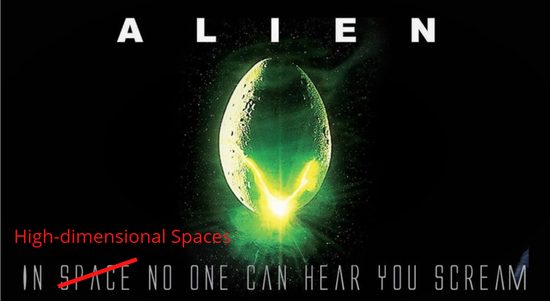


There are different approches to show this beahvior. Assume your data lives in the space $[0, 1]^p$, that is the unitary hypercube in the $p$-space. To capture a neighborhood which represents a fraction $s$ of the hypercube volume, you need the edge length to be $s^{1/p}$, such that $(s^{1/p})^p=s$:

In [4]:
percentages=np.linspace(0,1,101)
n_dims = [1,2,3,5,10,50, 100, 1000]
ten_percent = []
fig = go.Figure()

for p in n_dims:
    s = percentages ** (1/p)
    ten_percent.append(s[10])
    fig.add_trace(go.Scatter(x=percentages, y=s, mode='lines', line=LINE, marker=MARKER, name=p))

fig.add_trace(go.Scatter(x=[0.1]*(len(ten_percent)+2), y=[-100]+ten_percent+[100],
                         name='10 %', mode='lines+markers+text',
                         text=ten_percent,textfont=dict(size=9,color='black'), 
                         texttemplate="edge: %{y:.3f}", textposition='middle right', 
                         marker=dict(color='gray'),line={'width':1,'dash':'dot'},
                        )
             )
fig.update_layout(
    xaxis=(dict(range=[-0.02, 0.6],title='% Volume')), 
    yaxis=(dict(range=[-0.05, 1.05],title='Edge length')), 
    height=600,
    legend_title = 'Dimension:',
    title="Edge of hypercube needed to cover % of volume of unitary hypercube in different dimensions"
)
fig.show()

As we can see from the graph, this value rapidly explode for growing values of $p$. For example, as we can see in the plot above to capture the 10% of the volume of an 10D-hypercube, you need another 10D hypercube of segment $s = 0.1^{1/10} \simeq 0.8$. In other words in a 10D-hypercube of edge 0.8 is contained only the 10% of the information of the entire unitary 10D hypercube. This means that *the 10D-hypercube is practically empty*. 

Note that also the contrary is valid. Considering a $p$-hypercube with and edge length of $r=0.1$ we have that its volumes is $0.1^p$. When $p$ grows, the volume quickly becomes so small that the probability to caputre points from your neighborhood becomes very small.

Moreover, consider $X,Y$ two independents variables, with uniform on $[0,1]^p$. It can be proved that the mean squared distance $\|X-Y\|^2 satisfies:

$$ \mathbb E \big[\|X-Y\|^2\big] = p/6,\qquad std\big[\|X-Y\|^2\big] \simeq 0.2\sqrt p $$

In [5]:
a = np.array([2, 4, 10, 25, 50, 100,500, 1000])

    
fig = go.Figure()
fig.add_trace( go.Scatter(y = a/6, x=0.2*np.sqrt(a), line_shape='spline', mode='lines+markers+text',
              text=[f"$p={x}: \;\;\mu= {x/6:.2f}, \sigma\simeq {0.2*np.sqrt(x):.2f}$" for x in a],
              textposition = 'middle right',
                ))
             
fig.update_layout(title='Log/Log plot of mean/std distance between 100 points',
            yaxis=dict(title=f"$\log\mathbb E[\|X-Y\|^2]$", scaleanchor = "x",scaleratio = 1,type='log'), 
            xaxis=dict( title=f'$\log std[\|X-Y\|^2] $',type='log'), height=500)

We can analize the beahvior for different values of p. From a log-log plot we can clearly see a linear trend between the two varibles. This means that the expected valued of the mean squared distance grows exponentially with respect to the standard deviation. This means that for growing p, the average distance will increase very fast while the difference between the distances will be negliceble

> In high dimension the notion of distance will lose meaning

Practically what happens is that in higher dimensional spaces the concept of distance is losing it's mean. To show better this comportment we can draw 100 points uniformely from a $p$ unitary hypercube and plot the normalized distribution of the distances

In [6]:

n_dims = [2, 4, 10, 25, 50, 100,500, 1000]
n_samples = 100

df_distances = pd.DataFrame(columns=['distance', 'n_dim'], dtype=int)
stds = []

for p in n_dims:
    points = np.random.rand(n_samples, p) 
    dist = euclidean_distances(points).flatten()
    
    dist = dist[dist > 0] / max(dist)
    stds.append(dist.std())
    df_temp = pd.DataFrame({'n_dim':np.full(len(dist), p, dtype=np.int32), 'distance':dist})
    df_distances = df_distances.append(df_temp, ignore_index=True)

fig = px.histogram(df_distances,nbins=500,animation_frame = 'n_dim', labels={'n_dim':'number of dimensions', 'value':'euclidean distance / max(distance)'})

for i, frame in enumerate(fig.frames):
    frame.layout['annotations'] = [TEXT_ANNOTATION(0.2, 130, f"$std \simeq {stds[i]:.2f}$")]
        
for step in fig.layout.sliders[0].steps:
    step["args"][1]["frame"]["redraw"] = True

fig.update_layout(xaxis={'matches':None}, yaxis={'range':[0,150]}, showlegend=False,title='Normalized distribution of distances among 100 points')
fig.show()

## 1.4 The role of the datascientist
The machine learning statistical framework gives us guarantees on the learning activity, but it also show us that is fundamental to introduce some *human intelligence* in this framework in order to make it work. 

It is exactly here, where the *data scientist* comes in, injecting the real intelligent part in the system. Its work is to ***prepare the framework in order to make it work correclty.***.

Starting from the *raw data* and to anlayze it, clean it, shape it and craft it. This preparation is done thorugh a whole data-preparation pipeline, in which only last is the choice of correct algorithm that best suite our problem. 

In this sense the datascientist is a sort of data-craftsman that like every other artisan has its own (mathematical) toolbox that he/she needs to master.


# 2. PCA
Principal Component Analysis is probably the most famous and one of the oldest multivariate statistical technique. It was originally proposed by Karl Pearson in the 1907, but its current embodiement it's due to the work of Hotellyng, that in 1933 formalized the idea and firstly introduced the term *principal component*.

The idea at the base of PCA is to find an orthogonal set of vectors that spans the original space where the data are located. These vectors are not chosen randomly but are the ones that carry *the most information possible* of the original set. The information present in the data is considered in terms of variance. Hence, the vectors of the orthogonal basis are the **directions of maximum variance of the data**. These vectors are called **principal components** and are constructed as a *linear combination of the original features*. Moreover these vectors are ordered by importance, such that the first component is required to have the largest possible variance (the most information possible). The second component is the second for information carried and it's orthogonal to the first one, and so on.

<div class="quote">
  <blockquote>
PCA aims to find the most accurate data representation in a lower dimensional space
  </blockquote>
</div>

The idea of PCA is to find the *most accurate representation of the initial data in a lower dimensional space*. So for example if we have a set of 2D points and we map it to a 1D-line that is the first two principal components, we want that this projection is *the best possible 1D representation of our original points*. In this optic we can define the principal components as the ordered set of vectors that **minimize the orthogonal projection error**.

In [7]:
# Generate points
points = np.random.multivariate_normal((0,0), [[6, 3], [3, 6]], size=30)

frames = []
steps=  []
k = 8

pc1 = PCA().fit(points).components_[0]
pc1_phase = cmath.polar(complex(pc1[0], pc1[1]))[1]


for i,angle in enumerate(np.linspace(0,cmath.pi, 33)):
    
    # Computing projector
    u = cmath.rect(1.0, pc1_phase + angle)
    u = np.array([u.real, u.imag])
    projector_u = u[:,np.newaxis].dot(u[np.newaxis, :])/np.linalg.norm(u)
    
    # Projecting points
    projected_points = points @ projector_u
    rss = mean_squared_error(points, projected_points)
    
    # Extracting points for scatter plot
    final_points_x = np.array([(f_x, i_x, None) for i_x, f_x in zip(points[:,0], projected_points[:,0])]).flatten()
    final_points_y = np.array([(f_y, i_y,  None) for i_y, f_y in zip(points[:,1], projected_points[:,1])]).flatten()
    mask = np.array([('white', 'blue', 'yellow') for i_y, f_y in zip(points[:,1], projected_points[:,1])]).flatten()
    

    
    scatter = go.Scatter(x=final_points_x, y=final_points_y, mode='lines+markers',
                         marker=dict(size=8,color=mask, line=dict(width=1,color='grey')),
                         line=dict(color='crimson', width=0.7)
                        )

    # Preparing Frame
    frame = go.Frame(data = scatter, 
                     name=f'{angle:.2f}',
                     layout=go.Layout(annotations=[
                                 TEXT_ANNOTATION(-5,5,"$RSS = \sum_{i\in X}\|x_i - x_i^Tvv^T\|^2 = "+f"{rss:.2f}$",),
#                                  TEXT_ANNOTATION(-7,8,f"${(i/k):.2f}/{64//k} \pi$",)
                             ],
                                      shapes = [
                                          AXE(pc1[0]*12,pc1[1]*12,'pc1', 'rgb(55, 128, 191)'),
                                          AXE(u[0]*12,u[1]*12, 'rotation_axe', 'rgb(155, 128, 191)')
                                          ]
                                     )
                          )
    
    
    
    if i%k==0:
        slider_step = SLIDER_STEP(f'{angle:.2f}', 
                                  f'{i//k}/{32//k}π' if i != 0 and i != 32 else f'{i//32}π')
    else:
        slider_step = SLIDER_STEP(f'{angle:.2f}', f'')
    steps.append(slider_step)
    frames.append(frame)


fig = go.Figure(
    data= go.Scatter(x=points[:,0], y=points[:,1], mode='markers'),
    layout=go.Layout(
        xaxis=dict(range=[-8,8], autorange=False),
        yaxis=dict(range=[-8,8]),
        title="Residual Sum of Squares",
        updatemenus=[dict(
            type="buttons",
            buttons=[dict(label="Play",
                          method="animate",
                          args=[None, {"frame": {"duration": 80, "redraw": False},}]
                          )])],
        
        shapes = [AXE(pc1[0]*12,pc1[1]*12,'pc1', 'rgb(55, 128, 191)')]
    ),
    frames=frames
)


# Create and add slider
sliders = [dict(active=0, pad={"t": 50}, steps=steps)]
fig.update_layout(sliders=sliders, yaxis=dict( scaleanchor = "x",scaleratio=1), height=700)
fig.show()

## 2.1 Finding PCs

Consider a dataset $X\in\mathbb R^{m, n}$, where $m$ is the number of samples (or observations) each one with $n$ features (or parameters, or variables). Tipically a preprocessing is applied to prepare the data before the applciation of the PCA algorithm. The most common type of preprocessing is to subttract the mean of each variable from the dataset to center the data around the origin. Practically we apply a transformation of the type:

$$
x_i \quad\leftarrow \quad x_i - \mu, \qquad\forall \;x_i \in X^T
$$

where $\mu \in\mathbb R^n$ is the vector containing the empirical mean of each column of $X$ and $x_i$ is a sample (row) in the dataset. The final matrix will have **column-wise zero empirical mean**. A matrix of this type is said to be in *mean-deviation form*.

The change of coordinate system is done in the following manner. Consider the set of the principal components $\mathcal V = \{v_1, \ldots, v_n\}$ and the corresponding orthonormal matrix $V = [v_1, \ldots, v_n]\in\mathbb R^{n,n}$ whose columns are the principal components. The matrix $V$ is an orthonormal basis of the space $\mathbb R^n$, where the original data point (the observations) are located. For each row of the matrix $X$ $x_i\in \mathbb R^n$ we can retrieve the *projection along the component $k$* as:

$$ f_{i,k} = x_i^T \cdot v_k $$. 

We can do this for each component to obtain a new vector of *principal component scores*:

$$f_i = x_i^TV$$

In this context the matrix $V$ it tipically referred to as the *loadings matrix*. Note also that the vector $t_i$ represent the original sample $x_i$ in the new coordinate system of the principal components. We can think of projecting all the points obtaining the matrix of factors scores:

$$ F = XV $$


In the principal component coordinate systems, the variance along the direction $k$ can be expressed simply as $\sum_{i}(f_{k,i})^2$, since the points are mean-centered. As stated above, the goal is to find the directions of maximum variance. Considering the first principal component, we seek to find the direction $v_1$ that maximize the variance. We can write this problem mathematically as:

$$ v_1 = \displaystyle\arg\max_{\|v\|=1}\bigg\{\|Xv\|^2\bigg\} =\arg\max_{\|v\|=1}\bigg\{v^TX^TXv\bigg\} $$

Defining the vector $v$ as unitary, we can rewrite the problem in the form:

$$ v_1 = \displaystyle\arg\max\bigg\{\frac{v^TX^TXv}{v^Tv}\bigg\} $$

The function $\mathcal R(A,v) = \frac{v^TAv}{v^Tv}$ that maps $\mathbb R^n \mapsto \mathbb R$ is called **Rayleigh quotient**. From the *min-max theorem* we know that the maximum point corresponds to the leading eigenvector of the covariance matrix $A$. But we know even more, all the stationary points of this function are the eigenvectors of the matrix $A$ and their value are the corresponding eigenvalues.
The problem of finding the principal components so, resolves with an eigendecomposition of the covariance matrix $X^TX$.

<div class="quote">
  <blockquote>
    A set of orthogonal vectors that maximize the Rayleigh quotient of $XX^T$ is the set of eigenvectors of $X^TX$
  </blockquote>
</div>

## 2.2 Algorithm
The PCA algorithm can then be described in two simple steps:

1. Preprocessing the matrix
2. Retrieve the eigendecomposition of the matrix $X^TX$

First of all we need to preprocess our dataset $X\in\mathbb R^{m, n}$. Almost always, the columns of $X$ will be **zero-centered** such that the mean of each column will be 0. A matrix in this form is said to be in the mean-deviation form.
Tipically the elements of $X$ are also divided by $n-1$. In this case the model is referred to as *covariance PCA* since the matrix $X^TX$ is the covariance matrix of $X$. In other cases in addition to the centering, we can apply a standardization of each variable. In this case we tipically referr to a **correlation PCA** since the matrix $X^TX$ is the correlation matrix.


In [8]:
%%html

<figure align='center'>
<q style=" align:center; max-width: 200em;  margin: 1em;  font: 2.0rem/1.4 Georgia, serif">SVD is the Rolls-Royce and the Swiss Army knife of Numerical Linear Algebra.</q>

  <figcaption stylle = 'pad-left: 100px'>
    *Dianne O’Leary, <cite> MMDS ’06</cite>  </figcaption>
</figure>

For the second step performing an eigenvalue decomposition is not a trivial task. Fortunately it comes in our help an amazing math tool called **Singular Value Decomposition**. An SVD of a matrix $X$ is a factorization of the type$X = U\Sigma V^T$ where:

- $\Sigma$ is a  diagonal matrix whose entries $\sigma_i$ are called the *singular values* of X
- $U$ is an orthogonal basis whose columns are called the *left-singular vectors* of X
- $V$ is an orthogonal basis whose columns are called the *right-singular vectors* of X

The usufulness of the SVD decomposition, derives from the fact that exists a simple relation between the SVD decomosition of the centered matrix $X$ and the eigenvalue decomposition of the matrices $X^TX$ and $XX^T$ :

- $\sigma_i$ are the square roots of the eigenvalues of both $XX^T$ and $X^TX$
- the left singular vectors of $X$ are the eigenvectors of $XX^T$
- the right singular vectors of $X$ are the eigenvectors of $X^TX$

In [9]:
class myPCA():

    def __init__(self, n_components=None, use_std=False, solver='svd'):
        '''
        n_components: int or float[0,1]
            - if int is interpreted as the number of components to keep
            - if float is interpreted as the percentage of variance to keep

        use_std: bool, default=False
            - if False X will be only centered column-wise (covariance PCA)
            - if True X will be standardized considering also the std of each variable (correlation PCA)
        '''
        self.use_std = use_std
        self.n_components = n_components
        self.var_explained = None
        self.solver = solver

    def __scale_matrix(self, X):
        # Center the matrix
        self.mean = X.mean(axis=0)
        X_centered = X - self.mean

        # Scale the matrix
        if self.use_std:
            self.std = X.std(axis=0)
            X_centered /= self.std

        return X_centered

    def fit_transform(self, X):
        self.fit(X)
        return self.transform(X)

    def fit(self, X):
        '''
        Performs computation of the principal components on the dataset X

        X: np.array dim (m,n)
            - m is the number of samples (observations) in the dataset
            - n is the number of variables (features)
        '''
        self.n_samples, self.n_features = X.shape

        if self.solver == 'svd':
            X_centered = self.__scale_matrix(X)
            U, S, V = la.svd(X_centered)  # SVD decomposition of X
            self.U_, self.S_, self.V_ = U, S, V
            V = V.T  # eigenvectors of X^TX
            self.lambdas = (S ** 2) / (self.n_samples - 1)  # eigenvalues of X^TX

        elif self.solver == 'eig':
            X_centered = self.__scale_matrix(X)
            cov = (X_centered.T @ X_centered) / (self.n_samples - 1)
            self.lambdas, V = la.eig(cov)


        # Ordering eigs and eigenvectors
        i_lambdas = np.argsort(self.lambdas)[::-1]
        self.lambdas = self.lambdas[i_lambdas]
        V = V[:, i_lambdas]

        self.components_ = V
        self.__find_components()

    def __find_components(self):
        '''
        private method used to compute the number of components
        '''
        # compute variance explained for each component and cumulative variance explained
        tot_variance = np.sum(self.lambdas)
        self.relative_variance_explained = [x / tot_variance for x in self.lambdas]
        self.cumulative_variance_explained = np.cumsum(self.relative_variance_explained)

        if self.n_components is None:
            self.n_components = len(self.lambdas)
        elif type(self.n_components) is int:
            self.n_components = self.n_components
        elif 0.0 <= self.n_components and self.n_components <= 1.0:
            # if self.n_components is float in [0,1], compute the first index of cumulative variance
            # greater or equal to it
            self.n_components = np.argmax(self.cumulative_variance_explained >= self.n_components) + 1
        else:
            # in all the other cases set by default to max possible
            self.n_components = self.n_features

        self.var_explained = self.cumulative_variance_explained[self.n_components - 1]

    def transform(self, X, n_components=None):
        '''
        Projection of X into the principal component space
        '''
        if n_components is None or n_components > self.n_components:
            n_components = min(X.shape)


        B = X.copy()
        B -= self.mean
        if self.use_std:
            B /= self.std

        Vm = self.components_[:, :n_components]
        return B @ Vm

    def inv_transform(self, W, n_components=None):
        '''
        Reconstruction of the matrix from the principal component space
        '''
        if n_components is None or n_components >= self.n_components:
            n_components = min(W.shape[1], self.n_components)

        Vm = self.components_[:, :n_components]

        B = W @ Vm.T
        if self.use_std:
            B *= self.std
        B += self.mean
        return B


## 2.2 Variance explained and Dimensionality reduction
The main characteristic of PCA is that it gives us a very simple way to **quantify the relevance of each direction**. Indeed, for each direction of the new coordinate system we know how much information is related to it. The percentage of variance explained by each component $v_i$ can simply be computed as the fraction of the eigenevalue $\lambda_i$ corresponding to that component over the trace of the covariance matrix:

$$ \text{fraction_var_explained}_i = \frac{|\lambda_i|}{\sum_{j}|\lambda_j|}$$

This allow us a precise way to compute a dimensionality reduction, knowing exactly a-priori how much information are we gonna lose, giving us the possibility to do a *trade-off between the dimensionality of the feature space and the information we want to mantain*. Sorting the components by variance explained we can find that some of these components are entitled only for a small fraction of the total variance. This means that these directions are not much informative for the dataset and we can chose to drop them, mantaining only the first and more informative ones. 

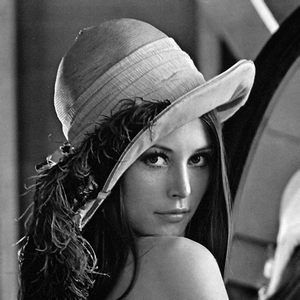

A classical application of PCA dimensionality reduction are images. Typically, an image is a tensor of pixels  of dimension $n\times m\times 3$, where the 3 stands for the **RGB** channels. We can convert the image in **grayscale** obtaining a matrix of pixels of dimension $n\times m\times 1$ and then apply PCA on it.

The image above is a classical test image of dimension 512 x 512 pixels. To show in practice the power of PCA, we can try to apply it on this image.


In [10]:
img = Image.open('./images/lena.png').convert('L')
X = np.array(img, dtype=float)

pca = myPCA()
pca.fit(X)

tot_variance = np.sum(pca.lambdas)
variance_explained = pca.relative_variance_explained
cum_var = pca.cumulative_variance_explained

df_variance = pd.DataFrame({'var':variance_explained,'pc':np.arange(len(variance_explained)) + 1})

fig = px.bar(df_variance, x='pc', y='var', labels={'var':'Variance Explained', 'pc':'Principal Component'}, 
                   title=f'Relative and Cumulative Variance explained',
                   text='var',
                   color='var'
                  )

fig.update_traces(texttemplate='%{text:.3f}', textposition='outside')
fig.update_layout(uniformtext_minsize=8)
fig.add_trace(go.Scatter(x=np.arange(len(cum_var))+1,
                         y=cum_var,
                         mode='lines+markers+text',
                         text=[''] +[f'{x:.2f}'if i%2 ==0 else '' for i,x in enumerate(cum_var[1:]) ],
                         textposition='top center',
                         line=DOT_LINE('gray'),
                         marker=dict(size=5),
                         name='cum var'))

fig.update_layout(yaxis={'range':[0.01, 1]}, xaxis={'range':[0, 21]},
                  coloraxis_colorbar=dict(yanchor="bottom", y=-0.05, x=1.01,
                  ticks="outside", title='',ticksuffix=" var"))
fig.show()
df_variance = None

### 2.2.1 Image reconstruction

In the picture above we can clearly see an example of the behaviour aforementioned. Only the first component account for around the 25% of the total variance, and the first 5 components account for over 66%. Moreover, the first 20 components accoutn for the 90% of the information present in the image. This means that the contribution summed of the remaining $492$ components account for less than the 10% of the total information. 

To show clearly what does this means practically, we can try to **project the image on lower spaces** considering increasing number of components, and then **reconstructing** an aproximation of the original image. As we can see, considering 100 principal components (99% of variance explained) the image reconstructed is practically identical to the original one. However, instead of dealing with a matrix of dimension $512\times512$, we now have to manage a matrix of dimension $512\times100$ 


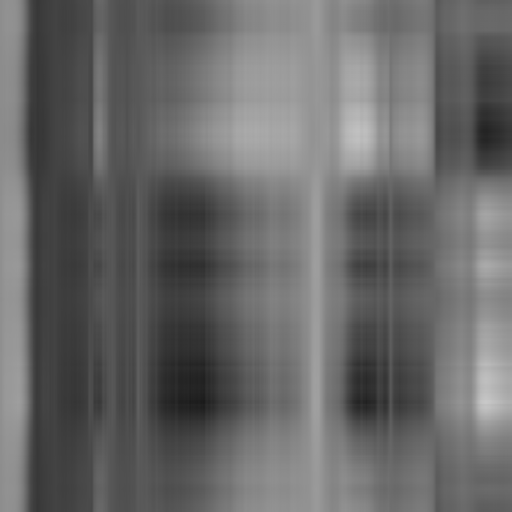
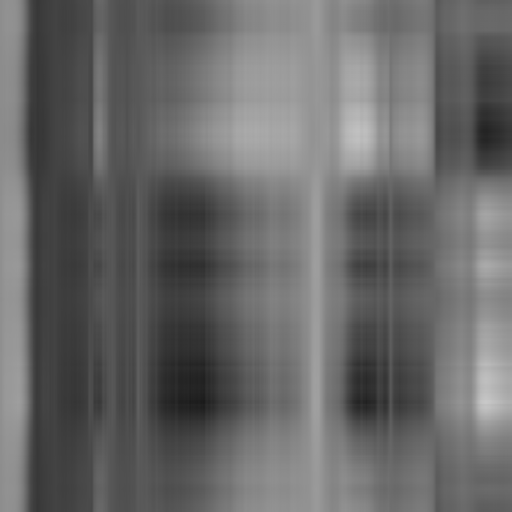
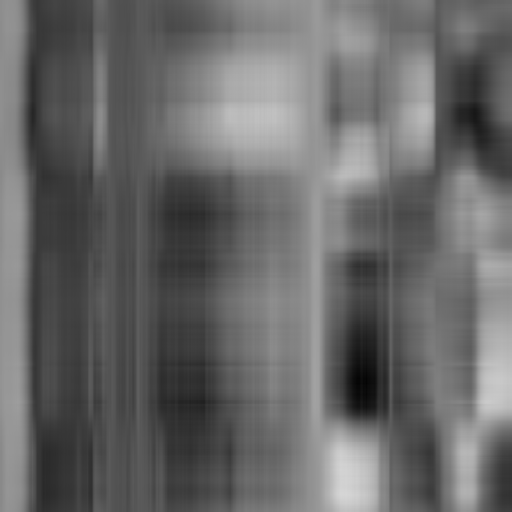
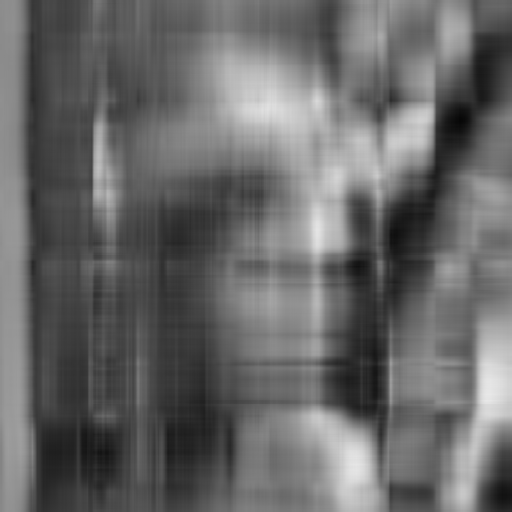
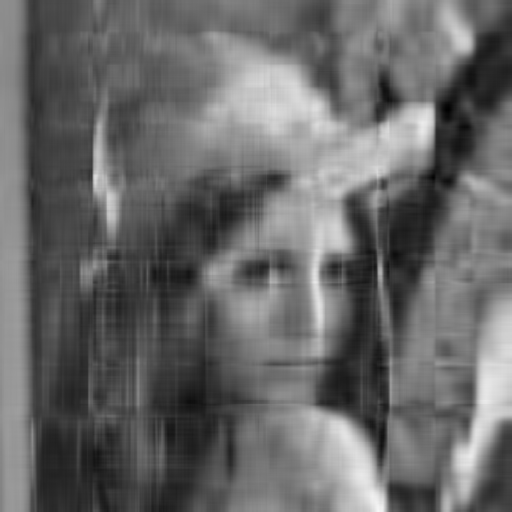
...
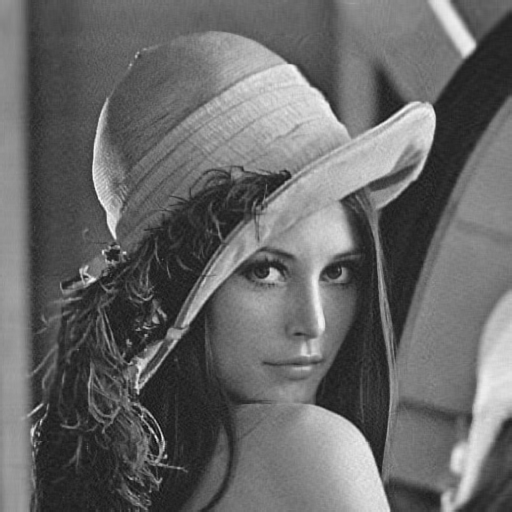
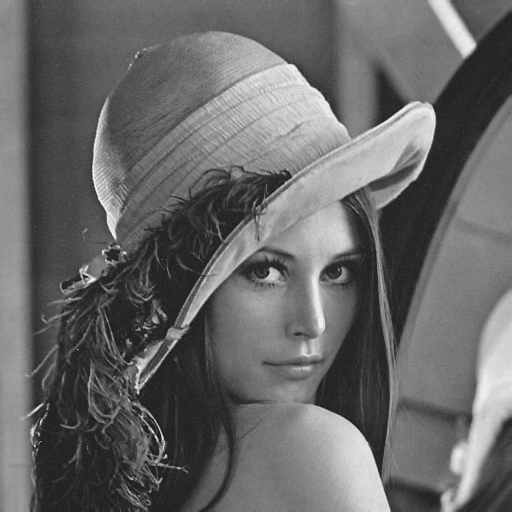
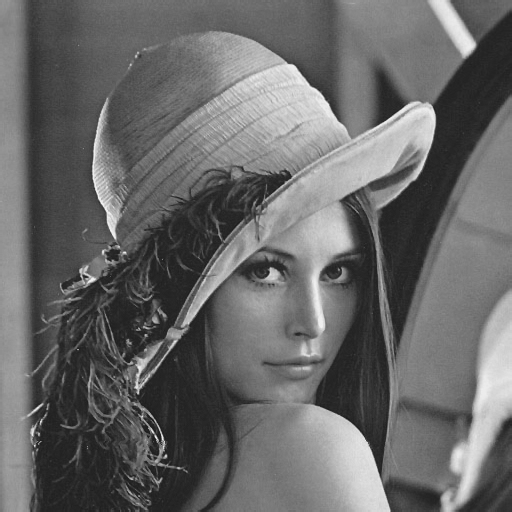
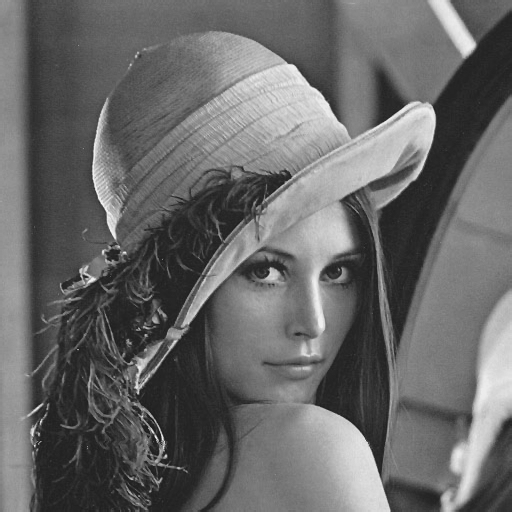
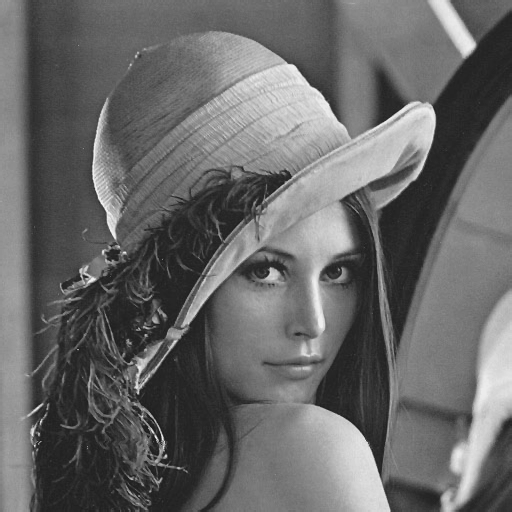

In [11]:
imgs = []
components = np.array([1, 2, 5, 10, 25, 50, 100, 200, 300,400, 512])

for n_comp in components:
    W = pca.transform(X, n_components=n_comp)
    img_reconstructed = pca.inv_transform(W, n_components=n_comp)
    imgs.append(img_reconstructed)
    
imgs=np.array(imgs, dtype=float)

fig = px.imshow(imgs,animation_frame=0, binary_string=True, labels=dict(animation_frame="num components"))
fig.update_layout(title = 'Lena reconstructed', 
                  sliders = [dict(name='Components',steps=[{'label':f'{x}'} for x in components])]
                 )


for i, frame in enumerate(fig.frames):
    frame.layout.title = f"Lena reconstructed: {components[i]} components ({pca.cumulative_variance_explained[components[i]-1]*100:.2f}% var explained)"
    
for step in fig.layout.sliders[0].steps:
    step["args"][1]["frame"]["redraw"] = True

fig.show()
imgs = None

# 3. Analyze PCA results

Principal Component Analysis is a very simple and effective tool but very often it is applied in a **black-box** approach to perform dimensionality reduction. However, PCA can be used also as an *exploratory tool*. Indeed, it can give us  some insight on the structure and distribution of our data. For this reason having a strategy to analyze the results of our pca model it's fundamental.

## 3.1 Test - Fifa 19 dataset

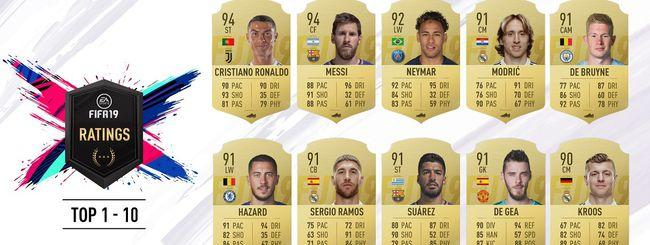


     
For the next part I will use a dataset containing all the players present in EA Fifa 19 (https://www.kaggle.com/karangadiya/fifa19). For each player, 88 attributes are recorderded. Some of them are generic attributes as "Name", "Nationality", "Photo" that is the url of the thumbnail or "Release Clause".

The attributes interesting for this part are the ones from column 53 to 87. These 34 attributes are related to different skills covering different technical areas like 'Finishing' or 'LongShoot' for strikers, 'Passing' and 'Vision' for midfielders, 'Tackling' and 'Interception' for defenders and 'GKDiving' and 'GKReflexes' for goalkeepers. For each player a score in the range $[0,100]$. The whole set of scores contributes to the **overall score** of the player.


In [12]:
df = pd.read_csv('data.csv', index_col=0)
features = df.columns[53:-1].tolist()
target = 'GeneralPosition'


mask_nan = np.any(np.isnan(df[features].values), axis=1)
df = df[~mask_nan]
X = df[features].values

df.head()

,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club Logo,...,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause
0,158023,L. Messi,31,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,94,94,FC Barcelona,https://cdn.sofifa.org/teams/2/light/241.png,...,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,€226.5M
1,20801,Cristiano Ronaldo,33,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,94,94,Juventus,https://cdn.sofifa.org/teams/2/light/45.png,...,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,€127.1M
2,190871,Neymar Jr,26,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,92,93,Paris Saint-Germain,https://cdn.sofifa.org/teams/2/light/73.png,...,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,€228.1M
3,193080,De Gea,27,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,91,93,Manchester United,https://cdn.sofifa.org/teams/2/light/11.png,...,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,€138.6M
4,192985,K. De Bruyne,27,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,91,92,Manchester City,https://cdn.sofifa.org/teams/2/light/10.png,...,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,€196.4M


The set of skills interesting for our analysis are the following

In [13]:
print(features)

['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing', 'Volleys', 'Dribbling', 'Curve', 'FKAccuracy', 'LongPassing', 'BallControl', 'Acceleration', 'SprintSpeed', 'Agility', 'Reactions', 'Balance', 'ShotPower', 'Jumping', 'Stamina', 'Strength', 'LongShots', 'Aggression', 'Interceptions', 'Positioning', 'Vision', 'Penalties', 'Composure', 'Marking', 'StandingTackle', 'SlidingTackle', 'GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes']


In Fifa 19 a lot of different *Positions* are considered to each area of the field. 

In [14]:
df.Position.unique()

array(['RF', 'ST', 'LW', 'GK', 'RCM', 'LF', 'RS', 'RCB', 'LCM', 'CB',
       'LDM', 'CAM', 'CDM', 'LS', 'LCB', 'RM', 'LAM', 'LM', 'LB', 'RDM',
       'RW', 'CM', 'RB', 'RAM', 'CF', 'RWB', 'LWB', nan], dtype=object)

To simplify the analysis each player is mapped to the area of the field which is more close to his position. In this manner, only 4 categories are considered as **GeneralPosition** : *Striker*, *Midfielder*, *Defender* and *Goalkeeper*.

In [15]:
def map_position_to_general(position):
    if position in ['ST', 'LF', 'CF', 'RF', 'LS', 'RS', 'LW', 'RW']:
        return 'ST'
    elif position in ['CAM', 'LM', 'CM', 'RM', 'CDM', 'LAM', 'RAM',
                     'LCM', 'LDM', 'RCM', 'RDM']:
        return 'MF'
    elif position in ['LWB', 'LB', 'CB', 'RB', 'RWB', 'LCB', 'RCB']:
        return 'DF'
    else:
        return 'GK'
    

df['GeneralPosition'] =df.Position.apply(map_position_to_general)
player_color_dict = {'GK': 0, 'DF': 1, 'MF': 2, 'ST': 3}
color_player_dict = {DEFAULT_PLOTLY_COLORS[v] : k for k,v in player_color_dict.items()}
df['Color'] = [DEFAULT_PLOTLY_COLORS[player_color_dict[k]] for k in df.GeneralPosition]

df[['Name', 'Position', 'GeneralPosition']].head()

,Name,Position,GeneralPosition
0,L. Messi,RF,ST
1,Cristiano Ronaldo,ST,ST
2,Neymar Jr,LW,ST
3,De Gea,GK,GK
4,K. De Bruyne,RCM,MF


In [16]:
pca = myPCA()
pca.fit(X)

V = pca.components_


tot_variance = np.sum(pca.lambdas)
variance_explained = pca.relative_variance_explained
cum_var = pca.cumulative_variance_explained

df_variance = pd.DataFrame({'var':variance_explained,'pc':np.arange(len(variance_explained)) + 1})

fig = px.bar(df_variance, x='pc', y='var', labels={'var':'Variance Explained', 'pc':'Principal Component'}, 
                   title=f'PCA: Relative variance explained',
                   text='var',
                   color='var'
                  )

fig.update_traces(texttemplate='%{text:.3f}', textposition='outside')


fig.update_layout(
     yaxis={'range':[-0.01, 0.7]}, xaxis={'range':[-0.05, 20]},
                  coloraxis_colorbar=dict(yanchor="bottom", y=-0.05, x=1.01,
                  ticks="outside", title='',ticksuffix=" var"))
fig.show()
df_variance = None


## 3.2 Intepreting Principal Components Results

### 3.2.1 Physical interpretation
Another way to look at the formulation of this problem is to consider each sample $x_i \in X.T, i=0,\ldots,n$ as a physical point and so the whole dataset as a phisical body. 
We can define the *inertia of a column* as the sum of the squared elements of the column:

$$ I_j^2 = \sum_{i=0}^m x_{i,j}^2 $$

The sum of all the column inertias is called *total inertia* or simply *inertia* of the data table:

$$ I = \sum_{j=0}^n I_j^2 = \sum_{j=0}^n\sum_{i=0}^m x_{i,j}^2 $$

The *center of gravity* $g$ is the vector of the means of each column of $X$, and the distance of each point from the baricenter is given by:

$$ d_{i,g}^2 =\sum_{j=0}^m (x_{i,j} - g_j) ^2 $$

Consider to put the dataset in meand-deviation form, or in this case to shift the body s.t. the baricenter is positioned to the origin. We have now that $g = \mathbb 0 \in\mathbb R^n$ and the distance of each point is:

$$ d_{i,g}^2 =\sum_{j=0}^m (x_{i,j}) ^2 = I_i $$

> The principal components are the **axes of inertia** of the body. The importance of each component is given by the proportion of inertia "explained"

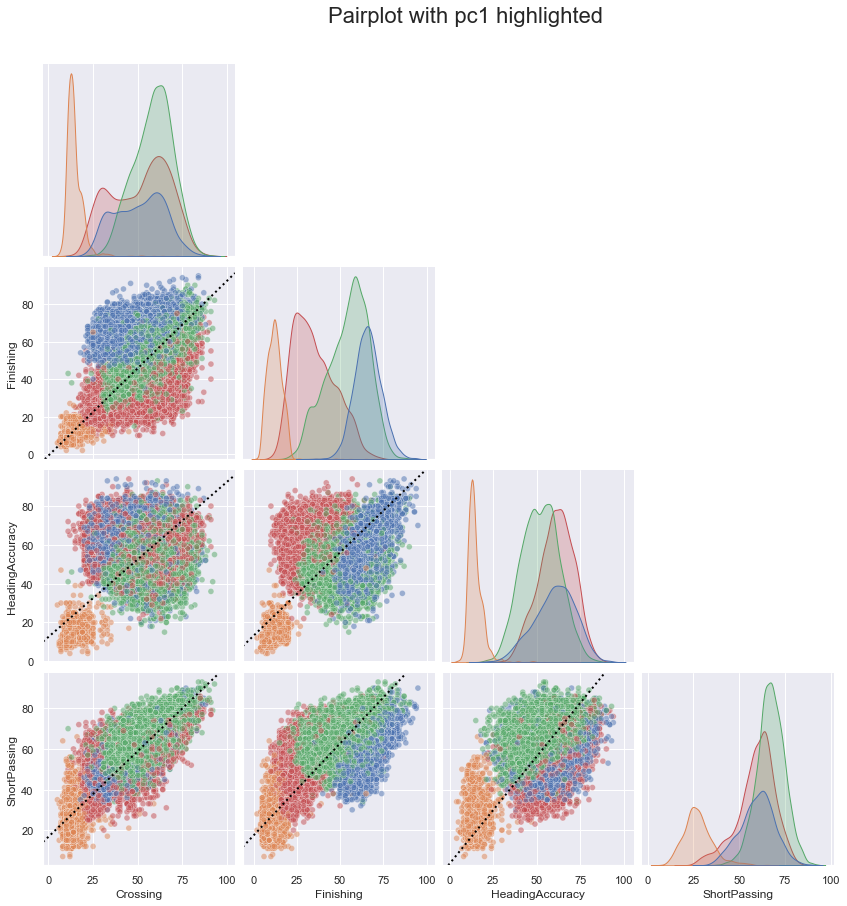

In [17]:
old_features =features
features = features[:4]
means = df[features].mean(axis=0)

g = sns.pairplot(df[features+[target, 'Color']],hue='Color', diag_kind='kde', height=3,  corner=True,
                 plot_kws={'alpha': 0.5})

g.fig.suptitle("Pairplot with pc1 highlighted", y=1.05, size=22) # y= some height>1


allaxes = g.fig.get_axes()
for i in range(1,len(features)):
    for j in range(i+1, len(features) + 1):
        mu = means.loc[[features[i-1], features[j-1]]].values
        u = np.array([V[:,0][i-1], V[:,0][j-1]])
        ax = allaxes[sum(range(j)) + i-1]
        ax.axline((-u[0] + mu[0], -u[1] + mu[1]), (u[0] + mu[0], u[1] + mu[1]), 
                  linestyle=':', c='black',lw=2, alpha=1, label='pc1 projected')


g._legend.set_title('Position')
g._legend.remove()

features = old_features

In the picture above are plotted the pair-plots of the first three features. Pair-plots are a very simple way to investigate *how variables interact in couples*. The plots are organized in a grid of dimension $\text{num_features}\times \text{num_features}$. In the plots $(i,j)$ outside the diagonal ($i\neq j$) are depicted the scatter plots of the coupled variables $i$ and $j$. Here we can investigate the interactions between these two variables.The diagonal plots are treated differently: a univariate distribution plot is drawn to show the marginal distribution of the data in each column.

The dotted line in black in the picture is the first principal component projected, in each subplot along the two corresponding variable. As we can clearly see, if we consider the storm of points as a physical body, the first principal component is the ax the capture the maximum inertia possible of the body.

### 3.2.2 Loadings

The matrix $V$ is called the *loadings matrix*. As seen before, each principal component is constructed as a linear combination of the original variables. The matrix $V$ contains the **coefficients of the linear combination**. In particular, for example considering the value $v_{i,k}$ it is the contribution of variable $i$ to the component $k$.

For each component we can plot the loadings as a barplot to look at the contirbution of each one of the original variables. Opposing positive and negative contributing features can help us to give an interpretation to the principal component

In [18]:
pc1 = pca.components_[:,0]
pc2 = pca.components_[:,1]

fig = make_subplots(rows=2, cols=1, subplot_titles=("pc1 Loadings", "pc2 Loadings"),
#             shared_xaxes=True,
            vertical_spacing=0.2 )
colors = np.full(len(pc1), 'lightgray')
colors[pc1 > 0.1] = 'crimson'
colors[pc1 < -0.1] = '#1f77b4'
fig.add_trace(go.Bar(
            y=pc1,
            x=features, marker_color= colors
            ), row=1, col=1)



colors = np.full(len(pc1), 'lightgray')
colors[pc2>0.15] = 'crimson'
colors[pc2<-0.16] = '#1f77b4'

fig.add_trace(go.Bar(
            y=pc2,
            x=features,marker_color= colors
            ), row=2, col=1)



fig.update_layout(height=800)
fig.update_layout(title='Loadings')

# fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, showlegend=False)
# rotate labels
fig.update_xaxes(tickangle=45,showgrid=True, row=1, col=1)
fig.update_xaxes(tickangle=45,showgrid=True, row=2, col=1)


The vertical barplots give us some important insight on the behaviour of the first two principal components. From the first plot we can see a clear positive contribution of Goalkeepr's attributes and a negative contribution of all the other attributes. The second plot, at a first glance seems to be less clear. However highlighting the most important attributes in absolute level, we can see a positive contribution of defensive attributes as 'Tackle', 'Marking' and 'Interception' and a negative contribution of attributes like 'Finishing', 'Longshots' and 'Volleys'. From the 2 plots above we can clearly interprete:
1. The first component is a discriminant between **Goalkeeprs** and other players
2. The second component is a discriminant between **Defensive/Offensive** players

### 3.2.3 Correlation between a Component and a Variable
The correlation between a component and a variable estimates the information that they share. Since the sum of the squared variables is equal to 1, a good way to plot them in a 2D space is to consider the unitary **circle of correlations**.

When the data are perfectly represented by only two components, the sum of the squared loadings is equal to one, and so the loading will be positioned on the circle. When two components are not enough to reconstruct a variable, the variable will be positioned inside the circle.

> The closer a variable is to the circle of correlations, the better we can reconstruct it from the first two components


In [19]:
W = pca.fit_transform(X)
A, B = np.array(W.T), np.array(X.T)
# A, B = np.array(W), np.array(X)

# Rowwise mean of input arrays & subtract from input arrays themeselves
A_mA = A - A.mean(1)[:, None]
B_mB = B - B.mean(1)[:, None]

# Sum of squares across rows
ssA = (A_mA**2).sum(1)
ssB = (B_mB**2).sum(1)

# Finally get corr coeff
corrs = np.dot(A_mA, B_mB.T) / np.sqrt(np.dot(ssA[:, None], ssB[None]))

(corrs**2).sum(axis=0)

features_to_plot = features
df_corrs = pd.DataFrame(corrs.T, index=features_to_plot)
df_corrs = df_corrs[[0,1]]


relative_variance = np.array(pca.relative_variance_explained)*100

fig = go.Figure()

fig.add_shape(type="circle",
    xref="x", yref="y",
    fillcolor="PaleTurquoise",
    opacity=0.2,
    x0=-1, y0=1, x1=1, y1=-1,
    line_color="LightSeaGreen",
)

fig.add_trace(go.Scatter(x=df_corrs[0], y=df_corrs[1], mode='markers+text',text=features_to_plot,
                         textfont=dict(size=12),
                         textposition = 'top center',
                         marker= dict(symbol='diamond-dot', color='crimson')
                        ))
fig.update_layout(yaxis=dict(scaleanchor = "x",scaleratio = 1, range=[-1.2,1.2], title=f'pc2 ({relative_variance[1]:.2f}% var)'),
                  xaxis=dict( range=[-1.2,1.2], title=f'pc1 ({relative_variance[0]:.2f}% var)'),
                  height= 700,
                  title = 'Correlation Circle'
                 )
fig.show()


### 3.2.4 Contribution of each observation
Consider the svd decomposition $X = U\Sigma V^T$, we have that the matrix of the factor scores:

$$ F = XV = U\Sigma V^T V =  U\Sigma$$

and so we have that the sum of the squared factors for each component is equal to the corresponding eigenvalue"

$$ F^TF = \Sigma^TU^TU\Sigma = \Sigma^T\Sigma \underset{\Sigma \text{ diagonal}}{=} \Sigma^2 $$

Having this in mind, we can quantify the contribution of each observation to a component as the partial variance (inertia) over the total variance (inertia) of the component:

$$ ctr_{i,k} =\frac{f_{i,k}^2}{\sum_{j=0}^mf_{j,k}^2} = \frac{f_{i,k}^2}{\lambda_k} $$

Obvsiously the contribution of each observation is in the range [0,1] while the sum of all the contributions for a component is $\sum_{j} ctr_{j,k} = 1$. 

> A tipical heuristic approach is based on interpreting the principal components considering the observation whose contribution is greater than the average contribution. In this case the observations that differ in sign can be opposed as the endpoints of the component


In [20]:
def contribution(X, pca, k):
    f = pca.transform(X)[:,k] **2
    return f/sum(f)


In [21]:
k = 0
ctrs0 = contribution(X, pca, 0)
ctrs1 = contribution(X, pca, 1)

df_temp = pd.DataFrame({'id': df.ID, 'contribution pc 1':ctrs0, 'contribution pc 2':ctrs1, target:df[target].values})
fig = px.scatter(df_temp, x = 'contribution pc 1', size=ctrs0*ctrs1*100, y='contribution pc 2', color=target, hover_data=['id'],
                labels={'contribution pc 1':'PC 1', 'contribution pc 2': 'PC 2'})
ix = np.argmax(ctrs0*ctrs1*100)
fig.add_annotation(ARROW_ANNOTATION(ctrs0[ix], ctrs1[ix], "Who's this?"))
fig.update_layout(title="Contribution to first 2 pc (size=ctr1*ctr2)")
fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
fig.show()

The contribution plot enforce our beliefs. We can see how the players that contribute the most to the first component are goalkeepers, while in the second component there is a hetergoeneous contribution of 'ST', 'MF' and 'DF'.

Highlighted in the plot there is a point whose contribution is very high in the second component, but also quite high in the first. Indeed, this player has the highest contribution of the entire dataset


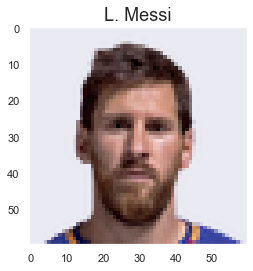

In [22]:
from PIL import Image
import io

import requests

# Extract player id

id_player =df_temp.iloc[ix].id
info = df[df.ID == id_player]

# Extract info
photo_url = f'https://cdn.sofifa.com/players/{str(id_player)[:3]}/{str(id_player)[3:]}/19_60.png'
name =  info.Name
info.set_index('Name', inplace=True)

# Download photo
my_referer = 'https://sofifa.com/?r=190075&set=true'
s = requests.Session()
s.headers.update({'referer': my_referer})
r = s.get(photo_url)

# Show photo
image = Image.open(io.BytesIO(r.content))
fig, ax = plt.subplots()
ax.imshow(image)
fig.set_facecolor("white")
plt.title(name.item(), size = 18)
plt.grid(False)
plt.show()

Digging into the dataset we can retrieve the informations relative to this player and we can see how this is not 'a player' but it's Lionel Messi, the highest overall-rated player in Fifa 19. Aside from it's overall, it's contribution to the goalkeeper component is probably due also to the fact that it has a score relative to 'GKKicking' and 'GKPositioning' and 'GKHandling' higher than the average of non-GK players

In [23]:
GK_attributes = ['GKDiving', 'GKHandling','GKKicking', 'GKPositioning', 'GKReflexes']
df_temp = pd.DataFrame(columns = GK_attributes, index=['mean', 'std'])
df_temp.loc['mean'] = df[df[target] != 'GK'].mean()[GK_attributes].values
df_temp.loc['std']  = df[df[target] != 'GK'].std()[['GKDiving', 'GKHandling','GKKicking', 'GKPositioning', 'GKReflexes']].values

print('Mean and std of GK attributes for non-GK players:\n')
print(df_temp)
stats = df[df.ID==id_player][['GKDiving', 'GKHandling','GKKicking', 'GKPositioning', 'GKReflexes']]
stats.index = name
stats

Mean and std of GK attributes for non-GK players:

      GKDiving GKHandling  GKKicking GKPositioning GKReflexes
mean  10.49907  10.556445  10.550118     10.529215  10.508436
std   3.095231   3.073416   3.140666      3.079219   3.100045


,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes
Name,,,,,
L. Messi,6.0,11.0,15.0,14.0,8.0


Finally we can plot the simple scores of the each observation along the first two components. This practically are the coefficients of each observation in the PCA base. Also from this plot we can clearly see how the first component is an attribute of **'Goalkeepingness'** while the second component is an attribute of **'Defensiveness'**

In [24]:
f = pca.transform(X, n_components=6)
ctrs0 = f[:, 0]
ctrs1 = f[:, 1]

df_temp = pd.DataFrame({'id': df.ID, 'contribution pc 1':ctrs0, 'contribution pc 2':ctrs1, target:df[target].values})
fig = px.scatter(df_temp, x = 'contribution pc 1', y='contribution pc 2', opacity=0.15,color=target, hover_data=['id'],
                labels={'contribution pc 1':'PC 1 (Goalkeepingness)', 'contribution pc 2': 'PC2 (Defensive/Offensive)'})

fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
fig.show()

## 3.3 Evaluating the quality of the model

### 3.3.1 Number of components
In many cases, we are only interested in extracting the important information from the dataset, *reducing the dimensionality* of the dataset as much as possible. So in this case we only want to know how many component we want to keep.
This question is not solved, but there are some useful guidelines to help us in our decision:

1. **Elbow method**: a first heuristic approach is to plot the eigenvalues according to their importance and look if in the graph there is point where the slope of the curve goes from steep to flat. This point is usually referred to as 'the elbow' and the procedure as the *scree* or *elbow test*


2. **Average method**: another traditional heuristic approach is to consider only the components whose contribution is larger than the average contribution, or in other words to consider only the components such that $\lambda_k > \frac{\sum_{i=1}^n\lambda_i}{n} = \frac{\mathcal I}{n}$. Note that in the case of a correlation PCA this boils down to only the components with $\lambda_k > 1$


In [25]:
pca = myPCA()
pca.fit(X)
V = pca.components_

tot_variance = np.sum(pca.lambdas)
variance_explained = pca.relative_variance_explained
cum_var = pca.cumulative_variance_explained

df_variance = pd.DataFrame({'var':variance_explained,'pc':np.arange(len(variance_explained)) + 1})

fig = go.Figure()



df_variance['color'] = [DEFAULT_PLOTLY_COLORS[4]]* len(df_variance)
fig = px.bar(df_variance, x='pc', y='var', labels={'var':'Variance Explained', 'pc':'Principal Component'}, 
                   text=[f'{x:.2f}' if i <= 5 else '' for i,x in enumerate(df_variance['var'])],
                    opacity = 0.15,
                    color = df_variance.color
                  )

fig.update_traces(textposition='outside')
fig.update_layout(uniformtext_minsize=8)
fig.add_trace(go.Scatter(x=list(np.arange(len(variance_explained))+1),
                         y=list(pca.relative_variance_explained) +[0],
                         mode='lines+markers',
                         opacity = 0.8,
                         marker=dict(size=6, color=DEFAULT_PLOTLY_COLORS[0], symbol='diamond'),
                         name='cum var'))

fig.add_trace(go.Scatter(x=[0,len(pca.lambdas)], y=[np.mean(variance_explained)]*2,mode='lines',line={'color':'red','dash':'dot','width':1.5}))


arrow = ARROW_ANNOTATION(3,pca.relative_variance_explained[2], 'ELBOW')
k = 2
arrow['font'] = dict(color=DEFAULT_PLOTLY_COLORS[k], size=18)
arrow['arrowcolor'] =DEFAULT_PLOTLY_COLORS[k]
arrow['arrowhead'] = 2
arrow['arrowwidth'] =1
arrow['ax'] = 100
arrow['ay'] = -200
fig.add_annotation(arrow)
fig.add_annotation(go.layout.Annotation(
            x=12,
            y=0.05,
            xref="x",
            yref="y",
            text=f'Average contribution: {np.mean(variance_explained):.2f}',
            showarrow=False,
            ))

fig.update_layout(title = 'Scree plot',
                  showlegend=False,
                  xaxis=dict(range=[0,15]),
                  yaxis=dict(range=[0,0.7]),
                  coloraxis_colorbar=dict(yanchor="bottom", y=-0.05, x=1.01,
                                          ticks="outside",
                                          title='',
                                          ticksuffix=" var"))
fig.show()

### 3.3.2 Fixed Effect Model
When the original dataset is considered to be the population of interest (we have all the data at the beginning and we work only on it as in the previous examples) PCA corresponds to a **Fixed Effect Model**. In this case in fact, the model parameters are fixed or non-random quantities. In this case PCA is *descriptive* and the the amount of variance of $X$ explained by a component indicates exactly its importance. In this case, we can quantify the quality of the PCA considering only the first $k$ components, as the *reconstruction error*. Consider the matrix $\hat X_{(k)}$ that is the approximation of $X$ considering only the the first $k$ components.

$$ \begin{aligned}\hat X^{(k)} &= U^{(k)}\Sigma^{(k)}V^{(k)T}\\
                               &= F^{(k)}V^{(k)T}\\
                               &= XV^{(k)}V^{(k)T}
   \end{aligned}
$$

Practically we are prokecting our original dataset $X$ onto the first $k$ principal components $V_{(k)}$, and then we are reconstructing an approximation of the original matrix with the inverse operation $V_{(k)}^T$ (inverse since $V$ is orthonormal). This approximation carries an error, due to the fact that we are considering only the first $k$ components

$$ X = \hat X^{(k)} + E $$

where $E$ is a matrix accounting for the error $X - \hat X_{(k)}$. We can quantify this error in different manner, but the most widely adopted approach is to consider the **Residual Error Sum of Squares**:

$$ \begin{aligned}RESS_k &= \|X - \hat X_k\|_F^2\\
                         &= \mathcal I - \sum_{i=1}^k \lambda_i\\
                         &= \sum_{i=k+1}^n \lambda_i
   \end{aligned}
$$

where $\|\cdot\|_F$ is the Frobenius norm. This error is quantifiable also as the sum of the eigenvalues which we are neglecting. The lower is the RESS the better is the model. Obviously increasing the number of components we will have a better estimation and considering $k=n$ all the components we will be able to reconstruct the original matrix $X$ perfectly.
   

### 3.3.3 Random Effect Model:  a naïve approach
Tipically the dataset that we have is only a subset of observations of the real population. Our goal is to estimate the value of new observations from this population. This framework correspod to a **Random Effect Model**. In this case, practically we are only *approximating the real parameters* of the PCA and  due to the randomness, we have to adopt different strategies to evaluate our PCA model. Usually these are based on *computer-based resampling techniques* such as **bootstrap** and **cross-validation**.

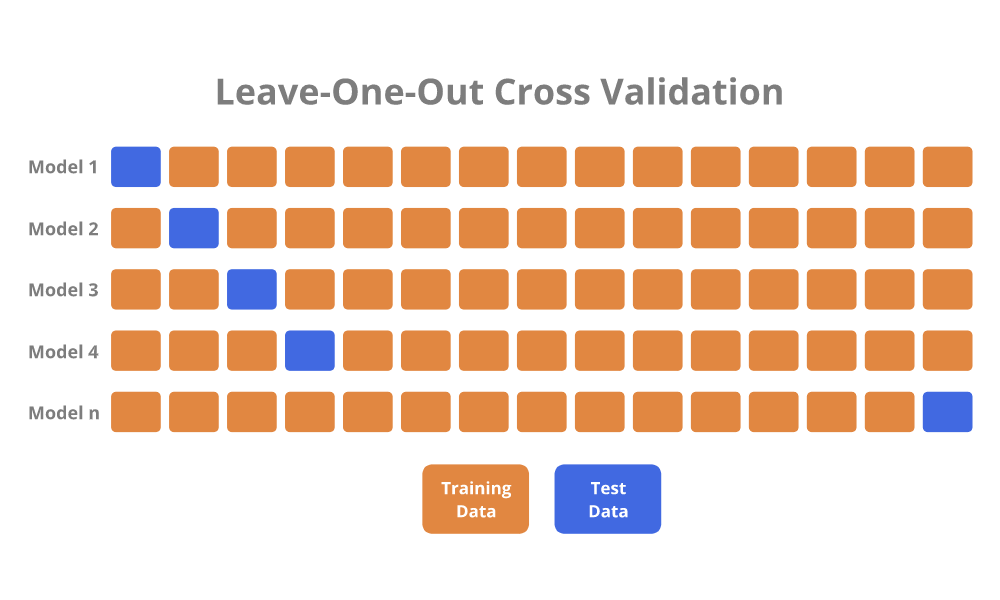

A popular cross-validation technique adopted in this context is the **jackknife** (or Leave One Out). In this procedure each observation is selected in turn, to form the test set. The remaining observations constitute the training set.
Then we will infere the PCA model on the training set and computing an estimation of the left-out sample considering the first $k$ component, according to a random effect model. We can store all this estimations in a matrix $\tilde X$ and finally computing the estimation error w.r.t. the original matrix $X$. Note that in this case we tipically talk of **Predicted Residual Error Sum of Squares**:

$$ PRESS_k = \|X - \tilde X_k\|_F^2 $$

As in the previous case the lower is the PRESS the better is the model. Note also that in contrast with the fixed effect model, even considering all the components we have *no guarantees to reconstruct perfectly X*.

> This problem shows up particularly when the number of variables is larger than the number of observations. This problem is referred to as the 'small N large P' in the literature

LVOO is a really computationally expensive method. In fact considering, $m$ samples we have to fit $m$ pca models on $m-1$ samples only to test on a single sample. Obviously, in the case of very large $m$ this become not duable. When we are in these situations we can adopt other techniques. **k-fold Cross Validation** consists in splitting the training set into *k* equal subsets and then applying the following iterative procedure:

    loop i = 1, ..., k:
        fit model on k-1 folds (excluding the i-th fold)
        test model on the i-th fold


### 3.3.4 Random Effect Model:  a correct approach
The method above present a subtle flaw. Consider a LVOO approach. At iteration $i$ we will consider the training set $X^{(-i)}$, that is the original data without the sample $x_i$. Then, we fit our PCA on $X^{(-i)}$, in order to retrieve the matrix $V^{(-i)}$ and finally we can compute the approximation error as:

$$ e_{i} = \|x_i - \hat x_i \|^2 = \|x_i - x_i^TV^{(-i)}V^{(-i)}T\|^2 $$

and from all the approximation errors compute the PRESS as:

$$ PRESS_{bad} = \sum_i e_{i} = \sum_i \|x_i - \hat x_i \|^2 = \|x_i - x_i^TV^{(-i)}V^{(-i)T}\|^2 $$

The problem is that this approach use the test set (the original $x_i$ sample) in order to compute the approximation of $x_i$ itself. It is like if in a classification problem we would use the correct test label in order to predict the same label. This approach is very prone to **overfitting** the data, tipically diminishing the PRESS score for increasing number of components, usually overestimating the number optimal number of components and so lowering the generalization abilities of our model.

There are different approaches to tackle this problem. Tipically they are based on the idea to consider a single column $x_{i,j}$ at time of the test set $x_{i}$ and reconstruct it:

$$ PRESS_{good} = \sum_{i=1}^m\sum_{j=1}^n | x_{i,j} - [V^{(-i)}(V^{(-i)}_{-j})^+x_{i,-j}]_j|^2$$


This approach is very computationally expensive. A variation of this approach consists into masking a percentage of our matrix. Consider a **masking matrix** $M$:

$$ 
M_{i,j} = \begin{cases}0 
 & \text{if }  validation\; point\\1
 & \text{if }  training\; point
\end{cases}$$

We can apply it to $X$ in order to left out a percentage of elements of the matrix. 

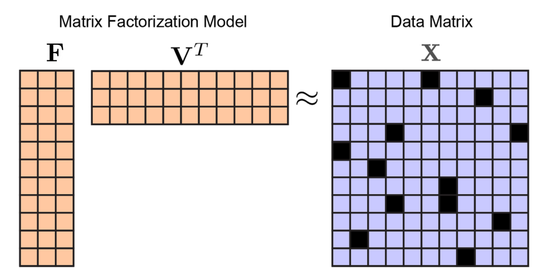

This is a well known optimization problem usually called **matrix completion**:

$$\min_{F,V}\|M\circ(FV^T - X)\|_F^2$$

where $\circ$ denotes the Hadamard product (element-wise product). The error of our model on the masked points as:

$$\min_{F,V}\|(1-M)\circ(FV^T - X)\|^2$$

A possible solution to this problem is constituted on an iterative method based on alternating least square minimization [3]

In [26]:
### Code revised from https://github.com/idc9/ya_pca

def lstsq(A, B, M):
    if A.ndim == 1:
        A = A[:,None]

    # else solve via tensor representation
    rhs = np.dot(A.T, M * B).T[:,:,None] # n x r x 1 tensor
    T = np.matmul(A.T[None,:,:], M.T[:,:,None] * A[None,:,:]) # n x r x r tensor
    try:
        # transpose to get r x n
        return np.squeeze(np.linalg.solve(T, rhs), axis=-1).T
    except:
        r = T.shape[1]
        T[:,np.arange(r),np.arange(r)] += 1e-6
        return np.squeeze(np.linalg.solve(T, rhs), axis=-1).T
    

def cv_pca(X, n_comp, p_holdout=0.2, n_iter=100, tol=1e-8, replicates = 3):
    
    # added tolerance to break iteration
    # add replicates with computation of mean error
    
    m,n = X.shape
    ranks = np.arange(1, n_comp)
    
    errors = {'train':{i:[] for i in ranks}, 
              'test':{i:[] for i in ranks}
             }
    
    M = np.random.rand(*X.shape) > p_holdout
    
    # fit models
    for rank, _ in itertools.product(ranks, range(replicates)):
        U = np.random.randn(m, rank)
        
        #iterative method
        for itr in range(n_iter):
            Vt = lstsq(U, X, M)
            U = lstsq(Vt.T, X.T, M.T).T
            
        resid = np.dot(U, Vt) - X
        
        train_err = np.mean(resid[M]**2)
        test_err = np.mean(resid[~M]**2)
        
        errors['train'][rank].append(train_err)
        errors['test'][rank].append(test_err)
        
    
    errors['train'] = {k:(np.mean(v), np.std(v)) for k,v in errors['train'].items()}
    errors['test'] = {k:(np.mean(v), np.std(v)) for k,v in errors['test'].items()}
    
    return errors

In [27]:
errors = cv_pca(X, 10, p_holdout=0.25, n_iter=70, replicates = 1)
train_error = [x[0] for x in errors['train'].values()]
train_std = [x[1] for x in errors['train'].values()]
test_error = [x[0] for x in errors['test'].values()]
test_std = [x[1] for x in errors['test'].values()]

In [28]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x=np.arange(len(train_error))+1, 
               y = train_error, mode='lines+markers',
               name = 'Train error'
              ))
fig.add_trace(
    go.Scatter(x=np.arange(len(test_error))+1, 
               y = test_error,
               name = 'Test error'))

fig.add_trace(go.Scatter(x = [3,3], y = [-30,300], line=DOT_LINE('black'), name='elbow'))
fig.update_yaxes(range=[-20,220], title='Mean Squared Error')
fig.update_xaxes(title='Number of Components')
fig.update_layout(title='PCA Cross validation')
fig.show()

# 4.  PCA Extensions


## 4.1 Kernel PCA

PCA is a very powerful method, but obviosuly is not flowless. PCA is a linear method and so it does perform well well if our data is linearly structured. 
What does this means practically? Consider a 2D-binary classification problem $\mathcal Y=\{0,1\}$ where each sample of our dataset is labeled with one of the two classes. The two classes are structured spatially in a non-linear way. For example in the plot below we can see two clusters of point organized in a XOR pattern around the origin

In [44]:
import math


colors = ['rgb(199,0,0)'] * 100 + ['rgb(31, 119, 180)'] * 100
colors_pr = ['rgba(199,0,0,0.15)'] * 100 + ['rgba(31, 119, 180, 0.15)'] * 100

cov = [[1.1,0],[0,1.1]]

k = 3
X = np.vstack((np.random.multivariate_normal([-k,k], cov, size= 50),
                   np.random.multivariate_normal([k,-k], cov, size= 50),
                   np.random.multivariate_normal([-k,-k], cov, size= 50),
                   np.random.multivariate_normal([k,k], cov, size= 50)
                  ))

pca = myPCA()
W = pca.fit_transform(X)


fig = make_subplots(rows=2, cols=2, column_widths=[0.1, 0.9], row_heights=[0.8, 0.2], vertical_spacing=0.1,
                    subplot_titles=("pc2 projection", 'XOR  example', '',"pc1 projection")
                   )

fig.add_trace(go.Scatter(x=X[:,0], y=X[:,1], mode='markers', marker=dict(color=colors)),row=1, col=2)

fig.add_trace(go.Scatter(x=[np.random.normal(0,0) for _ in range(200)], y=W[:,1], mode='markers',marker=dict(color=colors_pr)),
              row=1, col=1)

fig.add_trace(go.Scatter(y=[np.random.normal(0,0) for _ in range(200)], x=W[:,0], mode='markers',marker=dict(color=colors_pr)),
              row=2, col=2)



fig.update_layout(height=700, showlegend=False)
fig.show()



It's clear form the plot that PCA will never be able to find a direction onto which projecting these point, such that the point are separated. The problem here is that the baricenter of the two clusters coincide. 
Computing PCA on this dataset as it is and projecting the points, we will **destroy the structure of the data** and the points of the two classes are no more distinguishable.

As we have seen in the first part, tipically points in high dimensional space are very sparse. Intuitively we can think that they are also more easily linearly separable.
The idea here is exacltly this, we want to **move our data into an higher dimensional space**. We can do this *crafting some new non-linear features*. Imagine that we have some insight on the strucure of our data. For example in the case above we can consider a mapping function $\psi: \mathbb R^2 \rightarrow \mathbb R^3$ that maps $(u, v) \mapsto (u, v, uv)$. The range space of $\psi$ is called **feature space**. We can then map each of our sample to the feature space $x_i\mapsto\phi(x_i)$ and then apply PCA in the feature space

In [45]:
def mapping_function(point):
    x, y = point
    return (x, y, x*y)

X_features = np.array(list(map(mapping_function, X)))
x = X_features[:,0]
y = X_features[:,1]
z = X_features[:,2]

In [46]:
pca = myPCA()
W = pca.fit_transform(X_features)

# fig = px.scatter_3d(x = x, y=y, z=z, color=colors, opacity=0.99)

fig = make_subplots(rows=1, cols=2, column_widths=[0.2, 0.8],
                    subplot_titles=("PCA projection",  f'${"Feature space:"}\psi : (x, y) \mapsto (x, y, xy)$'),
                   specs = [[{'type':'xy'}, {'type':'scene'}]])

fig.add_trace(go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',


    marker=dict(
        
        color=colors,
        opacity=0.8
    )), col=2, row=1)

fig.add_trace(go.Scatter(x=W[:,1], y=W[:,0], mode='markers', opacity = 0.8,marker=dict(color=colors)),
              row=1, col=1)

fig.update_yaxes(title='pc1', row=1, col=1)
fig.update_xaxes(title='pc2', row=1, col=1)
fig.update_layout(
    showlegend=False,
    scene_camera =  dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1, y=1, z=0.45))
)
fig.show()

As we can see from the plot above, in the feature space the point are now linearly separable, thus PCA can perform well.

The basica ide can be summed up in three main points:
1. Given a domain set $\mathcal X$, choose a mapping $\psi: \mathcal X \rightarrow \mathcal F$ for some feature space $\mathcal F$ that is an Hilbert space
2. Map the points of the training set $x_i\in X^T \mapsto \psi(x_i)$ 
3. Perform PCA on the matrix $X_\psi\in\mathcal F$ that is the matrix of the feature space

Practically the success of this method boils down to the choice of a good mapping function $\psi$. 




### 4.1.1 Kernels in simple words

Computing the mapping into the feature space is computationally really expensive. Moreover, since the matrix $X_\psi$ is in a higher dimensional space, also the computation of the eigendecomposition of its covariance matrix is a computational burden. The solution to all these problems are *kernel functions*.
Given a mapping function $\psi:\mathcal X\rightarrow \mathcal F$, where $\mathcal F$ is an Hilbert space, we define a **kernel function** as:

$$ \mathcal K(\mathbf x_i, \mathbf x_j) = \langle \psi(\mathbf x_i),\psi(\mathbf x_j)\rangle=\psi(\mathbf x_j)^T\psi(\mathbf x_i), \qquad \mathbf x_i, \mathbf x_j \in  X^T$$

> The kernel function is a similarity measure between two points corresponding to an inner product in the space $\mathcal F$

The key point to a function to be a proper kernel is that it must represent a proper inner product and that $\mathcal F$ is a proper inner product space.

$$\begin{aligned}&{\textbf{(Mercer) Theorem:}} 
\text{ For any symmetric function } k:  X \times  X\rightarrow \mathbb R \text{ which is square integrable in }  \\ &X \times  X\text{ and which satisfies:}\\\;\\&\qquad\qquad\qquad \int_{ X \times  X}k(x, x')f(x)f(x')dxdx \ge 0, \quad \forall f\in L_2( X)\\\;\\ &\text{there exist }\phi_i:\mathcal X \rightarrow\mathbb R \text{ and  numbers }\lambda \ge 0 s.t.:\\\;\\&\qquad\qquad\qquad k(x, x') = \sum_i\lambda_i\phi(x)\phi(x'), \quad \forall x, x'\in X \end{aligned}$$

The first property in Mercer's theorem is called **(integrally) positive semidefinitness**. The double integral is a generalization in the continuos case of the *vector-matrix-vector* multiplication. Basically is like if we are considering an infinite matrix and we want it to be symmetric and positive semidefinite. However, tipically things are even easier, because we can restric ourselves only a discrete set of points given by our dataset $X$.
Considering the discrete case, the Mercer's condition requires that:

$${\displaystyle (g,Kg)=g^{T}{\cdot }Kg=\sum _{i=1}^{N}\sum _{j=1}^{N}\,g_{i}\,K_{ij}\,g_{j}\geq 0}$$


where $K$ is called **Kernel matrix** $K$ or *Gram matrix*:

$$ K = G = \begin{bmatrix}
\mathcal K(\mathbf x_1, \mathbf x_1) & \mathcal K(\mathbf x_1, \mathbf x_2) & \ldots & \mathcal K(\mathbf x_1, \mathbf x_m)\\
\mathcal K(\mathbf x_2, \mathbf x_1) & \mathcal K(\mathbf x_2, \mathbf x_2) & \ldots & \mathcal K(\mathbf x_2, \mathbf x_m)\\ 
\vdots & \vdots&\ddots & \vdots\\
\mathcal K(\mathbf x_m, \mathbf x_1) & \mathcal K(\mathbf x_m, \mathbf x_2) & \ldots & \mathcal K(\mathbf x_m, \mathbf x_m)\\  
\end{bmatrix}$$


Practically a kernel functionis a generalization of a **symmetric positive semidefinite matrix**. Restricting to the set $X$ we have from the Mercer's condition that $\mathcal K$ is a proper kernel function if $K$ is a positive semidefinite matrix.

Some of the most famous kernels are:

- polynomial kernel $\mathcal K(x,x')=(1 + \langle x, x' \rangle)^{k}$
- Radial Basis Function kernel ${\displaystyle \mathcal K(\mathbf {x} ,\mathbf {x'} )=\exp(-\gamma \|\mathbf {x} -\mathbf {x'} \|^{2})}$

### 4.1.2 Kernels the hard way

An Hilbert space $\mathcal H$ is a vector space where is defined an induced inner product $\langle \cdot, \cdot \rangle_\mathcal H$with the following properties:

- **Linear**: $\langle\alpha_1f_1 + \alpha_2f_2, g\rangle_\mathcal H = \alpha_1\langle f_1,g\rangle_\mathcal H + \alpha_2\langle f_2,g\rangle_\mathcal H$
- **Symmetric**: $\langle f, g\rangle_\mathcal H = \langle g, f\rangle_\mathcal H $
- the inner product of an element with itself is **positive semidefinite**: $\langle f, f\rangle_\mathcal H \ge 0$ and $\langle f, f\rangle_\mathcal H = 0 \iff f=0$

Now consider an arbitrary set $X$ and the hilbert space $\mathcal H$ of real-valued functions on $X$. For an element $x\in X$ we can define the **Dirac evaluation functional**

$$
\\\;\\
\begin{aligned}
\delta_x \quad :\quad &\mathcal H  \rightarrow X\qquad s.t.\; \delta_x(f) = f(x)\\
& f \mapsto f(x) 
\end{aligned} \\\;\\
$$

that is practically a linear functional that evaluates each function in  $\mathcal H$ at point $x$. We say that $\delta_x$ is bounded if there is a constant $M>0$ such that:

$$
\\\;\\
\|\delta_xf\| = |(f(x)|\le M\|f\|_\mathcal H\quad \forall f\in\mathcal H  \;\text{ and }\forall x \in \mathbb R^m
\\\;\\
$$

From this we have the following definition:

$$\\\;\\
\begin{aligned}&{\textbf{Definition:}} 
\\&
\text{A }\textbf{Reproducing Kernel Hilbert Space (RKHS)} \text{ is an Hilbert space }\mathcal H \text{ where all the Dirac}\text{ evaluation functionals in } \mathcal H\\& \text{ are bounded and continuous.}\end{aligned}
\\\;\\
$$


$$
\\\;\\
\begin{aligned}&{\textbf{(Riesz representation) Theorem:}}
\\&\text{Given a bounded linear functional } \varphi \text{ on an Hilbert Space } \mathcal H\text{, then there exists a unique } f_\varphi \in \mathcal H \text{ such that:}\qquad\qquad\quad
\\\;\\&\qquad\qquad\qquad \varphi(f) = \langle f, f_\varphi\rangle_\mathcal H\qquad \forall f\in\mathcal H
\end{aligned}
\\\;\\ 
$$




Considering the Dirac evaluation functionals, we get that for each $\delta_X$ there exists a unique $k_x\in\mathcal H$ such that:

$$ 
\delta_xf = f(x) = \langle f, k_x\rangle_\mathcal H 
$$


$$
\\\;\\
\begin{aligned}&{\textbf{Definition:}} 
\\&\text{Let }\mathcal H\text{ be } \mathcal L_2(X)\text{ the Hilbert space of functions from }X\text{ to }\mathbb R\text{. A function }\mathcal K: X\times X \rightarrow \mathbb R\text{ is called a }\textbf{Reproducing Kernel}\\&\text{of }\mathcal H\text{ if it satisfies: }
\\\;\\&\qquad\qquad \text{- }\forall x\in X,\;k_x = \mathcal K(\cdot, x) \in \mathcal H \qquad\text{( }k_x\text{ is called representer at } x\text{)}
\\&\qquad\qquad \text{- }\forall x\in X,\forall f\in \mathcal H,\;\;\langle f, \mathcal K(\cdot, x)\rangle = f(x) \qquad\text{(Reproducing property)}
\end{aligned}
\\\;\\
$$


Note that since $k_x\in\mathcal H$, this means that it is a function that maps $X\rightarrow \mathbb R$. So we have $k_x(y) = \mathcal K(x,y)$, and in particular for any $x, x' \in X$:

$$\mathcal K(x, x') = \langle\mathcal K(\cdot, x), \mathcal K(\cdot, x')\rangle_\mathcal H = \langle k_x, k_{x'}\rangle_\mathcal H $$

where $k_x$ and $k_{x'}$ are the unique representative of $\delta_x$ and $\delta_{x'}$. Note also that since $\langle \cdot, \cdot\rangle_\mathcal H$ is an inner product (symmetric positive definite) also $\mathcal K$.
The following properties hold:

- If it exists, the reproducing kernel for an Hilbert space $H$ it is unique
- The Dirac evaluation functionals $\delta_x$ over $\mathcal H$ are bounded and continuous if and only if $\mathcal H$ has a reproducing kernel $\mathcal K$


Reproducing kernels are a generalization of the kernel function defined above. Kernels in fact are a subset of reproducing kernels and so every reproducing kernel is also a kernel. This can be simply proved considering the mapping function:

$$
\\\;\\
\begin{aligned}
\psi \quad :\quad &X\rightarrow \mathcal H \\
& x\mapsto \mathcal K(\cdot, x) = k_x 
\end{aligned} \\\;\\
$$

and so the RKHS is the feature space $\mathcal F$ defined above.

The link that connects all this stuff is the Moore-Aronszjan theorem:

$$\\\;\\
\begin{aligned}&{\textbf{Moore-Aronszajn Theorem:}} 
\\&\text{Let }\mathcal K:X\times X\rightarrow \mathbb R \text{ be a positive definite kernel. Then there is a unique RKHS }\mathcal H_\mathcal K\in \mathbb R^X \text{ with reproducing kernel } \mathcal K\end{aligned}
\\\;\\
$$




### 4.1.3 The Kernel trick

The **representer theorem** states:

$$\begin{aligned}&{\textbf{Representer Theorem:}} 
\text{ Consider any learning rule of the form } \\\;\\
&\qquad\qquad\qquad 
\mathbf w^* = \arg\min_\mathbf w \Big(f(\langle\mathbf w, \psi(\mathbf x_1\rangle)), \ldots , f(\langle\mathbf w, \psi(\mathbf x_m\rangle)) + \mathcal R(\mathbf w)\Big)
\\\;\\ &\text{where }f:\mathbb R^m\rightarrow \mathbb R \text{ is an arbitrary function and } \mathcal R \text{ is a regularaziation term. Then:}
\\\;\\&\qquad\qquad\qquad \exists\;\mathbb \alpha \in\mathbb R^m \;s.t.\;\mathbf w^* = \sum_{i=1}^m\alpha_i\psi(\mathbf x_i)\end{aligned}$$

The basic idea to take advantage of kernels is to express PCA in the feature space in term of dot-products and then to exploit the duality between the kernel function and the dot product in order to formulate a version of the PCA that **avoids the direct computation of the covariance matrix in the $\mathcal F$ space**. The key idea is that we can express each principal component in the feature space $v_k^{(\psi)}$ as a linear combination of the points in the feature space.

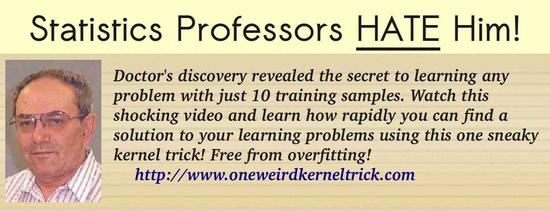


The trick is that KernelPCA does not compute directly the principal components of the covariance matrix $X_\psi^TX_\psi$ in the feature space, but it computes *the projection of our data onto those components*. 

$$ v_k^{(\psi)T}\psi(x_i) = \big(\sum_{j=1}^m \alpha_{j,k}\psi(x_j) \big )^T\psi(x_i) = \sum_{j=1}^m \alpha_{j,k}\big\langle\psi(x_i), \psi(x_j)\big\rangle =\sum_{j=1}^m \alpha_{j}\mathcal K(x_i, x_j) $$

Considering that $\mathcal K(\mathbf x_i, \mathbf x_j)=\psi(\mathbf x_j)^T\psi(\mathbf x_i)$ we have that the projection is simply a linear combination of the column $i$ of the kernel matrix. The problem boils down to compute the *factors* $\alpha_{i,k}$, and we can state it as:

$$ m\lambda\mathbf \alpha = K\mathbf \alpha$$

That is an eigendecomposition of the kernel matrix $K$ and where $m$ is the number of points.


### 4.1.4 Algorithm

Also in this case the algorithm is simple, and can be scomposed in three main steps:

1. Computation of the kernel matrix $K$
2. Preprocessing of the $K$
3. Eigendecomposition of $K$


The first part consist simply in the computation of the kernel matrix $K$ where each component $K_{i,j} = \mathcal K(x_i, x_j)$ for each couple of points in the dataset.

The second point is a bit trickier. PCA requires that the matrix on which is applied is zero-centerd. Even if the matrix $X$ is centered column-wise We cannot guarantee that the kernel matrix is centered as well. In this case we performe the following preprocesisng to the matrix $K$:

$$K \quad\leftarrow\quad K-{\mathbf  {1_{m}}}K-K{\mathbf  {1_{m}}}+{\mathbf  {1_{m}}}K{\mathbf  {1_{m}}}$$

where the matrix $\mathbf  {1_{m}}$ is an $m\times m$ matrix of the form:

$$\mathbf  {1_{m}}=
\frac{1}{m}\begin{bmatrix}
1&1&\ldots&1 \\
1&1&\ldots&1 \\
\vdots&\vdots&\ddots&\vdots\\
1&1&\ldots&1 \\
\end{bmatrix}\in\mathbb R^{m,m}
$$

Finally, also in this case we can solve the eigendecomposition problem of the kernel matrix through an SVD decomposition considering the matrix $K_{half} = K^{1/2}$ such that $K = K_{half}K_{half}^T$. In this case we can retrieve the eigendecomposition of $K$ throuhg the SVD decomposition of $K_{half}$


In [32]:
def poly_kernel(x1, x2, k=25):
    return np.power(1 + np.dot(x1, x2), k)

def rbf_kernel(X, gamma):
    sq_dists = pdist(X, 'sqeuclidean')
    mat_sq_dists = squareform(sq_dists)
    K = np.exp(-gamma *mat_sq_dists)
    return K

def kernel_matrix(X, kernel_fun):
    m = X.shape[0]
    G = np.ones((m,m))
    for i in range(m):
        for j in range(i, m):
            G[i,j] = kernel_fun(X[i], X[j])
            G[j,i] = G[i,j]
            
    return G


class myKernelPCA():

    def __init__(self, n_components=None, use_std=False, solver='svd', kernel=rbf_kernel, **kwargs):
        '''
        n_components: int or float[0,1]
            - if int is interpreted as the number of components to keep
            - if float is interpreted as the percentage of variance to keep

        use_std: bool, default=False
            - if False X will be only centered column-wise (covariance PCA)
            - if True X will be standardized considering also the std of each variable (correlation PCA)
        '''
        self.use_std = use_std
        self.n_components = n_components
        self.var_explained = None
        self.solver = solver
        self.kernel = kernel
        self.kwargs = kwargs


    def fit_transform(self, X):
        self.fit(X)
        return self.transform(X)

    def fit(self, X):
        '''
        Performs computation of the principal components on the dataset X

        X: np.array dim (m,n)
            - m is the number of samples (observations) in the dataset
            - n is the number of variables (features)
        '''
        self.n_samples, self.n_features = X.shape

        K = self.kernel(X, **self.kwargs)
        
        # centering
        one_matrix = np.ones((self.n_samples, self.n_samples)) / self.n_samples
        K = K - one_matrix.dot(K) - K.dot(one_matrix) + one_matrix.dot(K).dot(one_matrix)
        
        
        if self.solver == 'svd':
            G = la.fractional_matrix_power(K, 1/2)
            G = np.real_if_close(G, tol=1)
            U, S, V = la.svd(G)  # SVD decomposition of X
            V = V.T  # eigenvectors of X^TX
            self.lambdas = (S ** 2) / (n_samples - 1)  # eigenvalues of X^TX
            
        elif self.solver == 'eig':
            # eigendecomposition
            self.lambdas, V = la.eigh(K)
            self.lambdas = np.real_if_close(self.lambdas, tol=1)
            V = np.real_if_close(V, tol=1)

        # Ordering eigs and eigenvectors
        i_lambdas = np.argsort(self.lambdas)[::-1]
        self.lambdas = self.lambdas[i_lambdas]
        V = V[:, i_lambdas]

        self.components_ = V
        self.__find_components()

    def __find_components(self):
        '''
        private method used to compute the number of components
        '''
        # compute variance explained for each component and cumulative variance explained
        tot_variance = np.sum(self.lambdas)
        self.relative_variance_explained = [x / tot_variance for x in self.lambdas]
        self.cumulative_variance_explained = np.cumsum(self.relative_variance_explained)

        if self.n_components is None:
            self.n_components = len(self.lambdas)
        elif type(self.n_components) is int:
            self.n_components = self.n_components
        elif 0.0 <= self.n_components and self.n_components <= 1.0:
            # if self.n_components is float in [0,1], compute the first index of cumulative variance
            # greater or equal to it
            self.n_components = np.argmax(self.cumulative_variance_explained >= self.n_components) + 1
        else:
            # in all the other cases set by default to max possible
            self.n_components = self.n_features

        self.var_explained = self.cumulative_variance_explained[self.n_components - 1]

    def transform(self, X, n_components=None):
        '''
        Projection of X into the principal component space
        '''
        if n_components is None or n_components > self.n_components:
            n_components = min(X.shape)
        
        return self.components_[:, :n_components]

    def inv_transform(self, W, n_components=None):
        '''
        Reconstruction of the matrix from the principal component space
        '''
        if n_components is None or n_components >= self.n_components:
            n_components = min(W.shape[1], self.n_components)

        return W @ self.components_[:, :n_components].T

### 4.1.3 Test - Non-linear 2D points

To test the method, we can use the function *make_moons* from scikit-learn library. From the plot we can see ho, also in thi case, even if the baricenters are not overlapped, simple PCA does not perform really well

In [33]:
from sklearn.datasets import make_moons

X, y = make_moons(300, random_state = 42, noise=0.02)
colors = ['rgb(199,0,0)' if k==0 else 'rgb(31, 119, 180)' for k in y]
# px.scatter(x = X[:,0], y = X[:,1], color = colors, title='Half-Moon points')

pca = myPCA()
W = pca.fit_transform(X)


fig = make_subplots(rows=2, cols=2, column_widths=[0.1, 0.9], row_heights=[0.8, 0.2], vertical_spacing=0.1,
                    subplot_titles=("pc2 projection", '2D half moons', '',"pc1 projection")
                   )

fig.add_trace(go.Scatter(x=X[:,0], y=X[:,1], mode='markers', marker=dict(color=colors)),row=1, col=2)

fig.add_trace(go.Scatter(x=[np.random.normal(0,0) for _ in range(200)], y=W[:,1], mode='markers',marker=dict(color=colors_pr)),
              row=1, col=1)

fig.add_trace(go.Scatter(y=[np.random.normal(0,0) for _ in range(200)], x=W[:,0], mode='markers',marker=dict(color=colors_pr)),
              row=2, col=2)



fig.update_layout(height=700, showlegend=False)
fig.show()

However, we can see how the rbf kernel-PCA is able to deconstruct the original structure of the points, and that the points projected onto the kernel-principal-components are clearly linearly separable

In [34]:
fig = make_subplots(rows=2, cols=2,row_heights=[0.8, 0.2], vertical_spacing=0.15,
                    subplot_titles=("KPCA rbf gamma=15", "KPCA rbf gamma=50", 'kpc1', 'kpc1'),
                   )

for i,gamma in enumerate([15, 50]):
    kernelPCA = myKernelPCA(n_components = 2,solver='svd', kernel=rbf_kernel, gamma=gamma)
    W = kernelPCA.fit_transform(X)
    
    scatter = go.Scatter(x=W[:,0], y=W[:,1], mode='markers',
                         marker=dict(size=8,color=colors),
                        )

    
    fig.add_trace(scatter, row=i//2 + 1, col= 1 + i%2)
    fig.add_trace(go.Scatter(y=[0]*len(X), x=W[:,0], mode='markers', marker=dict(color=colors)),
          row=2, col=1+i)


fig.update_layout(showlegend=False)
fig.show()



## 4.2 ICA - Independent Component Analysis

> ICA aims to find a base of independent components.

Independent component analysis can be considered as a sort of evolution of PCA. ICA as the name suggest, tries to find *independent components* making advantage of statistics of higher order than the covariance, like at example Kurtosis.

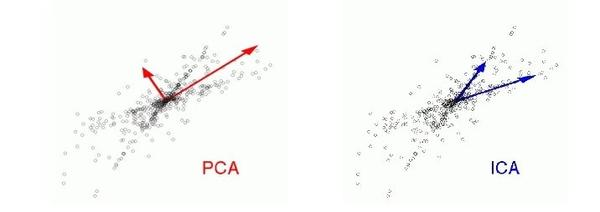


We assume that there exists a set of original signals $S$, such that each source $s_i\in S$ is independent from all the others $s_{j\neq i}\in S$. The dataset $X$ we have is considered to be as a set of observation, constructed as a *linear mixture of these source signals $s_i$*:

$$ X = AS$$

The matrix $A$ is called *mixing matrix*, and is an unknown invertible matrix of *mixing components*.

The main goal of ICA is to recover an approximation of the **unmixing matrix** $W\approx A^{-1}$, in order to retrieve the set of source signals $S$ starting from the set of observations $X$.

$$ S\approx \hat S= WX $$
 
 > Note that we have two unknowns in this problem: the mixing matrix $A$ and the set of sources $S$. The solution of this problem seems to be impossible since we have as observation only the matrix product of the two unknowns. 


This problem can be solved in a *divide-and-conquer* fashion. First we focus on finding $A$. Also in this case the SVD comes in our help. Given the decomposition $A=U\Sigma V^T$ of the original mixing matrix, we have that the unmixing matrix can be written as:

$$ W = A^{-1} = V\Sigma^{-1}U^T $$

We can now analyze the covariance matrix of observations $X$, and we have:

\begin{aligned}XX^T
& =  (AS)(AS)^T\\
& = (U\Sigma V^T\mathbf s)(U\Sigma V^T\mathbf s)^T \\
& = U\Sigma V^T \underbrace{S S^T}_{I} V\Sigma U^T \\
& = U\Sigma^2 U^T
\end{aligned}


Considering the eigenvalue decomposition $XX^T = EDE^T$ and comparing with the equation above we have that $U = E$ and and $\Sigma = D^{-1/2}$, as seen before for the PCA. We can rewrite the unmixing matrix, considering the resulots obtained:

$$ W = A^{-1} = V\Sigma^{-1}U^T = VD^{-1/2}E^T $$

The application of the matrices $D^{-1/2}E^T$ is a classical operation in signal processing. This operation is called **whitening**:

$$ X_w = (D^{-1/2}E^T)X $$

Whitening has the purpose to remove all linear dependencies in a data set (second order correlation) and normalizing the variance along each dimension. The resulting matrix $X_w$ is rotationally symmetric, like a sphere. For this reason this procedure is sometimes also called **sphering**.

$$X_wX_w^T = I_n = \begin{pmatrix}
1&0&\ldots&0\\
0&1&\ldots&0\\
\vdots&\vdots&\ddots&\vdots\\
0&0&\ldots&1
\end{pmatrix}\in \mathbb R^{n,n}$$




Now, the ICA problem boils down to find a single rotation matrix V, such that:

$$ \hat {S} = VX_w $$
	
The whitening step has removed all the linear dependencies between all pairs of variables based on second-order correlation; to recover $V$ we need to analyse other measures of dependency.

Statistical independence is the strongest measure of dependence between random variables. It requires that all order statistics of correlation (not only second) are vanishing. Only in this case we can have that the jointly probability distribution factorize to the product of the singular probability distributions. In the case of our original signals we require that:

$$ P(S) = \prod_{i}P(s_i) $$

Since with the whitening step we have removed the second-order correlations, what we want to do now is to find a rotation matrix $V$ that removes all the higher-order correlations. 
The solution to this problem comes from *information theory*. It can be proved that the matrix we seek is given by:

$$ V = \arg\min_{V} \sum_i H\big[(VX_w)_i\big] $$

where $\hat {s_i} = (VX_w)_i $ is the i-th component of the recovered signals $\hat S$, and $H[y] = -\int P(y)\log_2 P(y) dy $ is the *entropy*, a measure of the amount of uncertaint about the distribution $P(y)$.

Non-gaussianity serves as a proxy for statistical independence. In particular a solution of the equation above finds the rotation that maximizes the *"non-Gaussianity"* of the transformed data. The deviation of a probability distribution from a Gaussian is comoonly measured by the **negentropy**. Maximizing the negentropy (non-Gaussianit) is equivalent to minimize the sum of the marginal entropy.


### 4.2.1 FastICA
FastICA is an efficient and popular algorithm for independent component analysis invented by Aapo Hyvärinen at Helsinki University of Technology.

This algorithm is composed by two main steps:
1. **preprocessing step**
    * Firstly we *center* the matrix $ X = X - \mu $
    * Then we apply the *whitening* transformation $ X_w =  D^{-1/2}E^TX $
2. **component extraction step**
    * In the second part of we want to find the directions $w_i$ that maximizes a measure of non-Gaussianity of the vector $w_i^TX$. To measure non-Gaussianity, FastICA relies on a nonquadratic nonlinear function $f(u)$, its first derivative $g(u)$, and its second derivative $g'(u)$. Typical choices of these functions are:

    $$\begin{aligned}
    &f(u)=\log \cosh(u),&\quad g(u)=\tanh(u),&\quad {g}'(u)=1-\tanh ^{2}(u),\\
    &f(u) = -e^{-u^2/2},&\quad g(u) = u e^{-u^2/2},&\quad {g}'(u) = (1-u^2) e^{-u^2/2}
    \end{aligned}$$


The computation of the directions is done iteratively. For each direction $i$ we start from a random vector $w_i^{(0)}$. At each step we compute the next direction $w_i^{(k+1)}$ starting from the current one $w_i^{(k)}$ and the non-linear function $f(u)$:

$$w_i^{(k+1)} = E[Xg({w_i^{(k)}}^TX)^T] - E[g'(w^TX)]w_i^{(k)}\\
w_i^{(k+1)} = \frac{w_i^{(k+1)}}{\|w_i^{(k+1)}\|}
$$


Then we reothogonalize with respect to the directions already computed. The stopping criterion of the iteration can be  given as a tolerance (convergence of $|w_i^{(k+1)} - w_i^{(k)}|$) or as number of maximum iterations.

In [35]:

class myFast_ICA():

    def __init__(self, n_components=None, g_funct='tanh', tol=1e-8, num_iteration=1000, rng=None, seed=None):
        self.g_funct = g_funct
        self.n_components = n_components
        self.tol = tol
        self.num_iteration = num_iteration
        if rng != None:
            self.rng = rng
        elif seed != None:
            self.rng = np.random.default_rng(seed)
        else:
            self.rng = np.random.default_rng()
            
    def fit_transform(self, X, y=None):
        self.fit(X)
        return self.transform(X)

    def fit(self, X):
        tol = self.tol
        num_iteration = self.num_iteration
        X_ = np.array(X.T)
        n_samples, n_features = X_.shape

        if self.n_components==None or self.n_components >= min(n_samples, n_features):
            self.n_components = min(n_samples, n_features)

        # center the matrix
        mu = X_.mean(1, keepdims = True)
        X_centered = X_ - mu
        self.mean = mu

        # prewhitening with D^-1/2 U^T
        U, S, V = la.svd(X_centered, full_matrices=False)
        Z = (U / S).T[:self.n_components]  # Note that given XX^T = EDE^T we have that D = S^2 and E = U
        self.whitening_matrix = Z
        X_whitened = np.dot(Z, X_centered)* np.sqrt(n_features)

        # find components
        W = np.zeros((self.n_components, self.n_components))
        for p in range(self.n_components):

            # initial random guess
            wp = self.rng.random(size = self.n_components)
            wp = wp / la.norm(wp)

            for i in range(num_iteration):
                wp_old = wp
                
                # update vector
                u = wp_old.T @ X_whitened
                g, g_der  = self.__G(u)
                wp =  (X_whitened * g).mean(1) - g_der.mean() * wp_old

                # re-orhtogonalization through modified-Gram-Schmidt
                for j in range(p):
                    wp -= np.linalg.multi_dot([wp, W[:j+1].T, W[:j+1]])

                # normalization
                wp = wp / la.norm(wp);
                
                if la.norm(wp_old - wp ) < tol:
                    break

            W[p, :] = wp

        self.V = W
        self.W = W @ Z
        self.W = self.W.T

    def transform(self, X):
        B = X - self.mean.T
        return np.dot(B, self.W)

    def __G(self, x):
        if self.g_funct == 'tanh':
            tanh = np.tanh(x)
            return tanh, 1 - tanh * tanh
        elif self.g_funct == 'exp':
            exp = np.exp(-(x**2)/2)
            return  x * exp, ((1 - x**2) * exp)



### 4.2.2 Test - Cocktail Party Problem

ICA is used for *Blind Source Separation*. A typical application in the sound field is the so called *cocktail party problem*. Imagine we have different sound signals and different observations, given from example by some microphones. Each observation is a linear combination of the sources, where the coefficient associated at each source depends on different factors like the distance from the microphone and the microphone settings. The goal is to retrieve the original signals from the observations

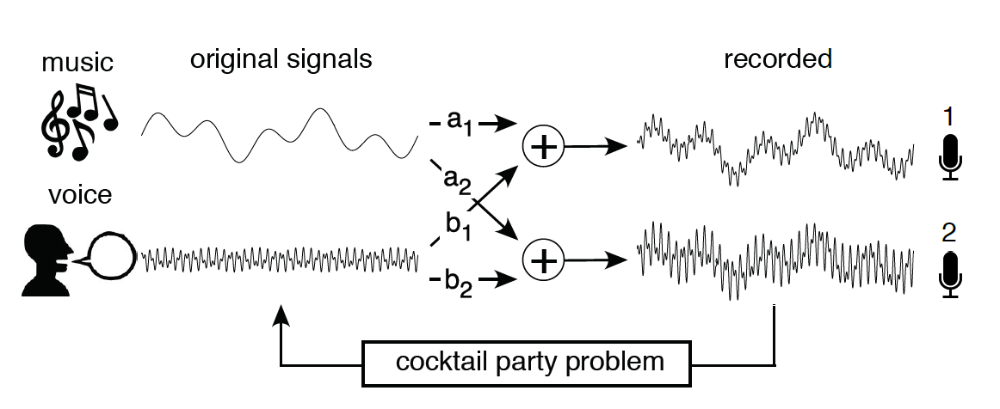

To test the goodness of my implementation, I have tried to apply it to a simple example of a cocktail party problem, following the example of present in the scikit library's documentation.

In this example, three source signals are generated: a *sinusoidal signal*, a *sqaure wave pulse* and a *sawtooth signal*.

The three original signals are then mixed with a random mixing matrix $A$ to generate the observations $X$. Finally both sklearn implementation of FastICA and mine are used to recover the original source signals

In [36]:
import IPython.display as ipd
from scipy.io.wavfile import read

AUDIO_NAME = ['train', 'laugh', 'gong']

fig = make_subplots(rows=3, cols=1)

S = []
for i,audio in enumerate(['audio/original_train.wav', 'audio/original_laughter.wav', 'audio/original_gong.wav']):
    x = read(audio)
    S.append(x[1])
    fig.add_trace(go.Scatter(mode='lines',x=np.arange(len(x[1])), y = x[1], name=AUDIO_NAME[i]), col=1, row=i+1)
S =np.array(S)
fig.update_layout(title='Original audio sources')
fig.show()

for i,s in enumerate(S):
    print(f'ORIGINAL: {AUDIO_NAME[i]}')
    ipd.display(ipd.Audio(s, rate=x[0]))

ORIGINAL: train


ORIGINAL: laugh


ORIGINAL: gong


To test the goodness of the algorithm we can import three sample audio signals. The three audio signals are plotted above.
Then with a random matrix we can simulate the mixing of these signals. Note how in a real application, tipically the only thing we have are the mixed signals in the plot belowe, and from these we want to retrieve the source signals on the top. As we can see even from this simple example, this is not at all a trivial problem. Looking at the three mixed signals, is very difficult to spot the underlying original signals.

In [37]:
import numpy as np
A = np.random.rand(3,3)
X = np.dot(A, S) 

fig = make_subplots(rows=3, cols=1)
for i,mix in enumerate(X):
    fig.add_trace(go.Scatter(mode='lines',x=np.arange(len(mix)), y = mix, name=f'mix-{i}'), col=1, row=i+1)
    
fig.update_layout(title='Mixed signals (microphones)')
fig.show()

for i,s in enumerate(X):
    print(f'MICROPHONE: {i+1}')
    ipd.display(ipd.Audio(s, rate=x[0]))

MICROPHONE: 1


MICROPHONE: 2


MICROPHONE: 3


In [38]:
myica = myFast_ICA(n_components=3, tol=1e-15, num_iteration=2000)
myica_S = myica.fit_transform(X.T)

fig = make_subplots(rows=3, cols=1)
for i in range(myica_S.shape[1]):
    fig.add_trace(go.Scatter(mode='lines',x=np.arange(myica_S.shape[0]), y = myica_S[:,i], name=f'reconstructed-{i}'), col=1, row=i+1)
    
fig.update_layout(title='Reconstructed signals (myICA)')
fig.show()

for i in range(myica_S.shape[1]):
    print(f'RECONSTRUCTED: {i+1}')
    ipd.display(ipd.Audio(myica_S[:,i], rate=x[0]))


RECONSTRUCTED: 1


RECONSTRUCTED: 2


RECONSTRUCTED: 3


Typical application of ICA includes the analysis of photographic images, medical signals (EEG, MEG, MRI), biological assays and obviously audio signal procesing. For example considering medical signals a tipical application regards 'artifact removals (https://sccn.ucsd.edu/~jung/Site/EEG_artifact_removal.html)

# References
[1] fifa19 dataset https://www.kaggle.com/karangadiya/fifa19

[2] Principal Component Analysis, Herve Abdi and Lynne J. Williams https://personal.utdallas.edu/~herve/abdi-awPCA2010.pdf

[3] http://alexhwilliams.info/itsneuronalblog/2018/02/26/crossval/

[4] Representer Kernel Hilbert space https://www.math.unipd.it/~demarchi/TAA1718/RKHS_presentazione.pdf

[5] FastICA pseudocode https://en.wikipedia.org/wiki/FastICA